# Abstract

The sale of automobiles in the United States, and the world have generally been on the rise in recent years, apart from the decline in sales due to the 08-09 financial crisis and the Coronavirus pandemic. In this notebook, we will take a look at a dataset sourced from Kaggle that is comprised of various features for thousands of new cars from various brands. This notebook will take you through the preprocessing of the uncleaned dataset, to the various sklearn regression algorithims and finally the conclusions about what features are the most important to predicting the MSRP of new cars. 

# Introduction

The problem I am addressing in this notebook is the prediction of new cars MSRP using various aspects of a car from the engine, to the drivetrain to the transmission of the car. Since the MSRP is unique to each car, this task is going to be performed using regression. The main information I am attempting to collect from this dataset is to determine what features of the car are the most important to determining and predicting the MSRP of a new car. Furthering that idea, another interesting point I want to explore is to see how many features are actually needed to give accurate predictions for these cars. Do we need to have every feature in our model to predict them accurately? or can we use only a handful of features that can predict MSRP just as accurate or better than using all the features?

# Motivation/ State of the Art

I choose to do this task because I have always enjoyed researching and understanding the aspects of various cars. My mom has liked cars throughout here life, and her love for them moved down from her to me. I always try and help people pick out new cars to buy given what they are looking for and the price point they set out. I feel this task can enhance my view on how MSRP are set based on the various features, although I have an relative idea of what is important to determining the MSRP of cars.

I have looked around for other notebooks that are performing this task using my dataset or similar datasets. Unfortunately, the dataset I selected does not have any prediction results, but I have found similar datasets that are doing the same task. Many of the notebooks used an R^2 value to measure the performance of their models, which prompted me to use the both, RMSE and R^2 to measure my performance. I looked for notebooks that used the same models I did, and I found that the best scores were:

Random Forest

*   R^2: .932057
*   RMSE: 0.255886

Decision Tree

*   R^2: 0.87650
*   RMSE: DNF

Support Vector Regression

1.   R^2: 0.4394
2.   RMSE: DNF

I am trying to surpass these scores, however, these scores were trained and tested on different datasets, so we can compare them, but we need to understand that the scores will vary based on that information. But, overall, I am looking for which features are the most important in determining the MSRP of new cars.






#Data

The dataset contains information about various cars from different brands ranging from the MSRP, to the type of brake used in the car to much more. The data has 32,316 instances with 57 featurs,and the features are fully described below. I sourced this dataset from [Kaggle](https://www.kaggle.com/prassanth/new-cars-price-2019), which contained a cleaned dataset and an uncleaned dataset, I choose to start with the uncleaned dataset. This meant that there is a lot of data preprocessing that had to be done inorder to get the data ready for the models. In this section, I take you through the steps of data cleaning, data exploration and data preprocessing.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [ ]:
df = pd.read_csv('https://raw.githubusercontent.com/blakeluther/csv/master/New_cars_price.csv')
orig_row, orig_col = df.shape

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (15,16,55) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [ ]:
df.head()

,Model,MSRP,EPA Fuel Economy Est - City (MPG),Engine,EPA Classification,Style Name,Drivetrain,Passenger Capacity,Passenger Doors,Body Style,Transmission,Base Curb Weight (lbs),Passenger Volume (ft³),Wheelbase (in),"Track Width, Front (in)","Height, Overall (in)","Fuel Tank Capacity, Approx (gal)",SAE Net Torque @ RPM,Fuel System,SAE Net Horsepower @ RPM,Displacement,Trans Description Cont.,Trans Type,Brake Type,Steering Type,Suspension Type - Front,Suspension Type - Rear,Air Bag-Frontal-Driver,Air Bag-Frontal-Passenger,Air Bag-Passenger Switch (On/Off),Air Bag-Side Body-Front,Air Bag-Side Body-Rear,Air Bag-Side Head-Front,Air Bag-Side Head-Rear,Brakes-ABS,Child Safety Rear Door Locks,Daytime Running Lights,Traction Control,Night Vision,Rollover Protection Bars,Fog Lamps,Parking Aid,Tire Pressure Monitor,Back-Up Camera,Stability Control,Basic Miles/km,Basic Years,Corrosion Miles/km,Corrosion Years,Drivetrain Miles/km,Drivetrain Years,Turning Diameter - Curb to Curb (ft),Front Wheel Material,Front Tire Size,Stabilizer Bar Diameter - Front (in),Roadside Assistance Years,Roadside Assistance Miles/km
0,2019 Acura RDX Specs: FWD w/Technology Pkg,"$40,600",22,"Turbo Premium Unleaded I-4, 2.0 L",Small Sport Utility Vehicles 2WD,FWD w/Technology Pkg,Front Wheel Drive,5,4,Sport Utility,Transmission: 10-Speed Automatic -inc: sequent...,3790,104.0,108.3,64.2,65.7,17.1,280 @ 1600,Gasoline Direct Injection,272 @ 6500,2.0 L/122,Automatic w/OD,10,4-Wheel Disc,Rack-Pinion,Strut,Multi-Link,Yes,Yes,No,Yes,No,Yes,Yes,Yes,Yes,Yes,Yes,No,No,No,Yes,Yes,Yes,Yes,"50,000",4.0,Unlimited,5.0,"70,000",6,39,Aluminum,P235/55HR19,NaN,4,"50,000"
1,2019 Acura RDX Specs: FWD w/Advance Pkg,"$45,500",22,"Turbo Premium Unleaded I-4, 2.0 L",Small Sport Utility Vehicles 2WD,FWD w/Advance Pkg,Front Wheel Drive,5,4,Sport Utility,Transmission: 10-Speed Automatic -inc: sequent...,3829,104.0,108.3,64.2,65.7,17.1,280 @ 1600,Gasoline Direct Injection,272 @ 6500,2.0 L/122,Automatic w/OD,10,4-Wheel Disc,Rack-Pinion,Strut,Multi-Link,Yes,Yes,No,Yes,No,Yes,Yes,Yes,Yes,Yes,Yes,No,No,Yes,Yes,Yes,Yes,Yes,"50,000",4.0,Unlimited,5.0,"70,000",6,39,Aluminum,P235/55HR19,NaN,4,"50,000"
2,2019 Acura RDX Specs: FWD w/A-Spec Pkg,"$43,600",22,"Turbo Premium Unleaded I-4, 2.0 L",Small Sport Utility Vehicles 2WD,FWD w/A-Spec Pkg,Front Wheel Drive,5,4,Sport Utility,Transmission: 10-Speed Automatic -inc: sequent...,3821,104.0,108.3,64.2,65.7,17.1,280 @ 1600,Gasoline Direct Injection,272 @ 6500,2.0 L/122,Automatic w/OD,10,4-Wheel Disc,Rack-Pinion,Strut,Multi-Link,Yes,Yes,No,Yes,No,Yes,Yes,Yes,Yes,Yes,Yes,No,No,Yes,Yes,Yes,Yes,Yes,"50,000",4.0,Unlimited,5.0,"70,000",6,39,Aluminum,P255/45VR20,NaN,4,"50,000"
3,2019 Acura RDX Specs: FWD,"$37,400",22,"Turbo Premium Unleaded I-4, 2.0 L",Small Sport Utility Vehicles 2WD,FWD,Front Wheel Drive,5,4,Sport Utility,Transmission: 10-Speed Automatic -inc: sequent...,3783,104.0,108.3,64.2,65.7,17.1,280 @ 1600,Gasoline Direct Injection,272 @ 6500,2.0 L/122,Automatic w/OD,10,4-Wheel Disc,Rack-Pinion,Strut,Multi-Link,Yes,Yes,No,Yes,No,Yes,Yes,Yes,Yes,Yes,Yes,No,No,No,No,Yes,Yes,Yes,"50,000",4.0,Unlimited,5.0,"70,000",6,39,Aluminum,P235/55HR19,NaN,4,"50,000"
4,2019 Acura RDX Specs: AWD w/Technology Pkg,"$42,600",21,"Turbo Premium Unleaded I-4, 2.0 L",Small Sport Utility Vehicles 4WD,AWD w/Technology Pkg,All Wheel Drive,5,4,Sport Utility,Transmission: 10-Speed Automatic -inc: sequent...,4026,104.0,108.3,64.2,65.7,17.1,280 @ 1600,Gasoline Direct Injection,272 @ 6500,2.0 L/122,Automatic w/OD,10,4-Wheel Disc,Rack-Pinion,Strut,Multi-Link,Yes,Yes,No,Yes,No,Yes,Yes,Yes,Yes,Yes,Yes,No,No,No,Yes,Yes,Yes,Yes,"50,000",4.0,Unlimited,5.0,"70,000",6,39,Aluminum,P235/55HR19,NaN,4,"50,000"


In [ ]:
print("In the dataset, there are {} rows and {} columns.".format(orig_row, orig_col))

In the dataset, there are 32316 rows and 57 columns.


## Description of Variables



*   Model - Car model names
*   MRSP - Selling price in dollars
*Engine - Type of engine used in car
*EPA Classification - EPA size classes (Mini compact, Midsize ,, Compact, Mid-Size, SUV)
*Style Name - Special features for each model (Drivetrain, Transmission, Roof, Doors, extra features) ****
*Drivetrain - Types of drivetrain(Conveys power from the engine to wheels) used (FWD, RWD , AWD, 4WD )
*Passenger Capacity - Number of people who can be seated
*Passenger Doors - Number of doors in a car
*Body Style - Body style of the car
*Transmission - Type of transmission used. (Not req -- Trans type, Trans Description cont.)
*Base Curb Weight - Total weight of the vehicle in pounds
*Passenger Volume - Volume of space available for passengers
*Wheelbase - Distance between the centers of the front and rear wheels
*Track Width Front - Distance between the centerline of two front wheels
*Height Overall - Overall height of the car in inches
*Fuel Tank Capacity, Approx(gal) - Fuel tank capacity in gallon
*SAE Net Torque @ RPM - Net optimum torque at a certain range of RPM
*Fuel System - Type of fuel injection used in car
*SAE Net Horsepower @ RPM - Horsepower produced at engine crankshaft(without transmission losses)
*Displacement - Measure of the cylinder volume swept by all of the pistons (in liters)
*Trans Description - Type of transmission used in car
*Trans Type - Number of gears in the transmission
*Brake Type - Type of brake used in car
*Suspension type Front - Type of Suspension used in car front wheels
*Suspension type Rear - Type of Suspension used in car rear wheels
*Air Bag Frontal Driver - Drivers Airbag(Y/N)
*Air Bag Frontal Passenger - Front passenger Airbag(Y/N)
*Air Bag-Side Body-Front - Airbags in front side of the car(Y/N)
*Air Bag-Side Body-Rear - Airbags in rear side of the car(Y/N)
*Air Bag Side Head-Front - Side airbags to protect head for front row(Y/N)
*Air Bag Side Head-Rear - Side airbags to protect head for rear row(Y/N)
*Brakes -ABS - Is Antilock bracking system is present(Y/N)
*Child Safety Rear Door Locks - Child safety door locks(Y/N)
*Daytime Running Lights - (Y/N)
*Traction Control - Is TCS available (Y/N)
*Night Vision - Thermographic camera to increase a driver's perception in darkness (Y/N)
*Rollover Protection Bar - Is ROPS present (Y/N)
*Fog Lamps - Is fog lamps present(Y/N)
*Parking Aid - Senors to monitor nearby obstacles(Y/N)
*Tire Pressure Monitor - Y/N
*Back up Camera - Is reversing camera present (Y/N)
*Stability Control - Is ECS present (Y/N)
*Basic Miles/km - Warrany Kms
*Basic Years - Warranty years
*Corrosion Miles/km - Warranty against corrosion
*Corrosion Years - Warranty against corrosion in years
*Drivetrain Miles/Km - Warranty for drivetrain
*Drivetrain Years - Warranty for drivetrain in years
*Turning Diameter Curb to Curb(ft) -Diameter of the smallest circular turn by the car
*Front Wheel Material - Material in which wheel is made up of
*Front Tire Size - Width , Aspect ratio , Speed rating , Rim size
*Stabilizer Bar Diameter - Front (in) - Diameter of the front sway bar
*Roadside assistance in years - Roadside assistance provided in terms of years
*Roadside Assistance Miles/km - Roadside assistance provided in terms of miles



## Data Preprocessing & Cleaning

I am going to go through each of the features to ensure the formatting for each feature is correct, and to make sure each feature is suitable to be used in the models.

In [ ]:
df_cleaning = df.copy()

### Changing Data types, if Needed

In its current state, the data in each column may not be represented correctly. That means that numbers may be represented as string/ object types while they should be int/ float data types. This section is dedicated to fixing these incorrect data types to their correct type.

In [ ]:
print("Feature | Data Type")
print("----------------------")
df_cleaning.dtypes.transpose()

Feature | Data Type
----------------------


Model                                    object
MSRP                                    float64
EPA Fuel Economy Est - City (MPG)       float64
Engine                                   object
EPA Classification                       object
Style Name                               object
Drivetrain                               object
Passenger Capacity                        int64
Passenger Doors                           int64
Body Style                               object
Transmission                             object
Base Curb Weight (lbs)                  float64
Passenger Volume (ft³)                  float64
Wheelbase (in)                          float64
Track Width, Front (in)                 float64
Height, Overall (in)                    float64
Fuel Tank Capacity, Approx (gal)        float64
SAE Net Torque @ RPM                     object
Fuel System                              object
SAE Net Horsepower @ RPM                 object
Displacement                            

From this, there are a lot of object type features where they should be represented as floats or ints. We are going to need to change the data types of these variables. For example, we need to the 'MSRP' feature as it is a object type, because of its included '$' and '.' in its values. We need to remove these as well before we can convert them to numerical data types.

In [ ]:
to = df_cleaning['MSRP'].copy()
to = [str(x).replace('$','').replace(',','').replace(" ",'') for x in to]
to = pd.Series(to)
to = pd.to_numeric(to, errors='coerce')
df_cleaning['MSRP'] = to

I have defined a function below that automatically replace ","s with "" in each observation of the features that have numerical numbers like (16,000), and then replace the old values in the features the newly altered features. I have created a list of features that have these formatting issues, and will go through each to replace the values in each feature.

In [ ]:
def convertToIntWithC(col):
  l = list(df[col])
  l = [str(x).replace(',','') for x in l]
  l = pd.Series(l)
  return l

In [ ]:
def convertToNumeric(col):
  df_cleaning[col] = pd.to_numeric(df_cleaning[col],errors='coerce')

In [ ]:
def convertColToNumerical(col):
  df_cleaning[col] = convertToIntWithC(col)
  convertToNumeric(col)

In [ ]:
list_to_change = ['EPA Fuel Economy Est - City (MPG)','Base Curb Weight (lbs)', 'Height, Overall (in)', 'Fuel Tank Capacity, Approx (gal)', 'Trans Type',
                  'Basic Miles/km', 'Drivetrain Miles/km','Roadside Assistance Miles/km', 'Drivetrain Years', 'Turning Diameter - Curb to Curb (ft)',
                  'Roadside Assistance Years', 'Roadside Assistance Miles/km', 'Corrosion Miles/km']

for col in list_to_change:
  convertColToNumerical(col)

### Duplicated Entries

First thing I want to look at is if there are any duplicated entries in the data. I am going to use the built-in pandas function of .duplicated() to search the dataframe for any double entries.

In [ ]:
duplicates = df_cleaning[df_cleaning.duplicated()]

In [ ]:
duplicates

,Model,MSRP,EPA Fuel Economy Est - City (MPG),Engine,EPA Classification,Style Name,Drivetrain,Passenger Capacity,Passenger Doors,Body Style,Transmission,Base Curb Weight (lbs),Passenger Volume (ft³),Wheelbase (in),"Track Width, Front (in)","Height, Overall (in)","Fuel Tank Capacity, Approx (gal)",SAE Net Torque @ RPM,Fuel System,SAE Net Horsepower @ RPM,Displacement,Trans Description Cont.,Trans Type,Brake Type,Steering Type,Suspension Type - Front,Suspension Type - Rear,Air Bag-Frontal-Driver,Air Bag-Frontal-Passenger,Air Bag-Passenger Switch (On/Off),Air Bag-Side Body-Front,Air Bag-Side Body-Rear,Air Bag-Side Head-Front,Air Bag-Side Head-Rear,Brakes-ABS,Child Safety Rear Door Locks,Daytime Running Lights,Traction Control,Night Vision,Rollover Protection Bars,Fog Lamps,Parking Aid,Tire Pressure Monitor,Back-Up Camera,Stability Control,Basic Miles/km,Basic Years,Corrosion Miles/km,Corrosion Years,Drivetrain Miles/km,Drivetrain Years,Turning Diameter - Curb to Curb (ft),Front Wheel Material,Front Tire Size,Stabilizer Bar Diameter - Front (in),Roadside Assistance Years,Roadside Assistance Miles/km


There are no duplicated entries in the data, so we do not have to worry about any double entries.

### Checking for Missing/Null/NaN entries

We are looking for any missing data in the dataframe. In the graph below, you can scroll through the table to look at the features, the number of values missing and the percent of values missing for each feature.

In [ ]:
import plotly.graph_objects as go

In [ ]:
missing = list(df_cleaning.isnull().sum())
percent_missing = [round((miss / orig_row) * 100, 2) for miss in missing]

In [ ]:
cols = list(df.columns)

In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['Feature', 'Number of Values Missing', 'Percent Missing %']),
                               cells=dict(values=[cols, missing, percent_missing]))])
fig.show()

Since the MSRP is the feature we want to predict, I am going to drop the 54 instances where the MSRP is missing. Additonally, I want to drop the "Stablizer Bar Diameter - Front (in)" feature because of the high amount of missing values, 65.17% missing.

In [ ]:
df_cleaning = df_cleaning.drop('Stabilizer Bar Diameter - Front (in)',axis=1)

In [ ]:
df_cleaning = df_cleaning[df_cleaning['MSRP'].notnull()]

In [ ]:
r,c = df_cleaning.shape
percentLeft = (r / orig_row) * 100
print("We are now using {} instances in our data, {}% of the original data.".format(r, percentLeft))

We are now using 32262 instances in our data, 99.83290011139992% of the original data.


### Looking for Irregularities

In this section, I am looking for weird and irregular data in any of the numerical features, at this point. I printed out the described data for each of the features.

In [ ]:
df_cleaning.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
MSRP,32262.0,37707.459426,32392.375762,6929.00,23140.0,30557.5,40758.75,548800.0
EPA Fuel Economy Est - City (MPG),26269.0,19.557197,5.563364,9.00,16.0,18.0,22.00,66.0
Passenger Capacity,32262.0,4.762972,1.825248,0.00,4.0,5.0,5.00,15.0
Passenger Doors,32262.0,3.262972,1.155429,0.00,2.0,4.0,4.00,4.0
Base Curb Weight (lbs),19376.0,3610.666887,694.800793,1808.00,3155.0,3500.0,4048.00,8591.0
Passenger Volume (ft³),16718.0,100.472854,21.955288,21.28,90.8,97.5,104.00,188.4
Wheelbase (in),30247.0,117.859369,18.074680,73.50,105.1,111.5,126.00,178.0
"Track Width, Front (in)",20077.0,61.681440,2.627045,50.00,60.0,61.6,63.20,69.4
"Height, Overall (in)",30089.0,65.296883,9.324475,44.30,57.4,65.5,73.50,110.8
"Fuel Tank Capacity, Approx (gal)",30095.0,20.753727,6.371399,1.90,16.0,19.0,26.00,48.0


Looking at the described data for the numerical information, most of the data looks to be in good shape, but one issue with the data is in the "Passenger Capacity" and "Passengers Doors" features. There are observations for these categories that have 0 capacity and 0 doors. Having a car with zero capacity makes no sense, I will be dropping those instances with those values. Additionally, cars with 0 doors does not make sense either, all cars I know of have at least 2 doors, these instances may include motorcycles, but I want to focus on predicting car prices, so I will be dropping those instances with 0 doors, as well.

In [ ]:
df_cleaning = df_cleaning[df_cleaning['Passenger Capacity'] != 0]
df_cleaning = df_cleaning[df_cleaning['Passenger Doors'] != 0]

In [ ]:
r,c = df_cleaning.shape
percentLeft = (r / orig_row) * 100
print("We are now using {} instances in our data, {}% of the original data.".format(r, percentLeft))

We are now using 30293 instances in our data, 93.73994306226018% of the original data.


## Taking a Look at the Features

In this section, I will be performing exploratory data analysis and seeing how these features affect MSRP, and to also, work on the individual formatting issues that each feature may have.

### Model

If you look at the head of the dataset, you will see that the model has the full model name for each car such as '2019 Acura RDX Specs: FWD w/Technology Pkg'. I am going to extract the year and the manufacturer for every car as there is not a year feature nor a manufacturer feature. I think by extracting these, our regression will become better.

In [ ]:
df_cleaning['Year'] = df_cleaning['Model'].str.split(" ").str[0]
df_cleaning['Manufacturer'] = df_cleaning['Model'].str.split(" ").str[1]
df_cleaning = df_cleaning.drop('Model',axis=1)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42]),
 <a list of 43 Text major ticklabel objects>)

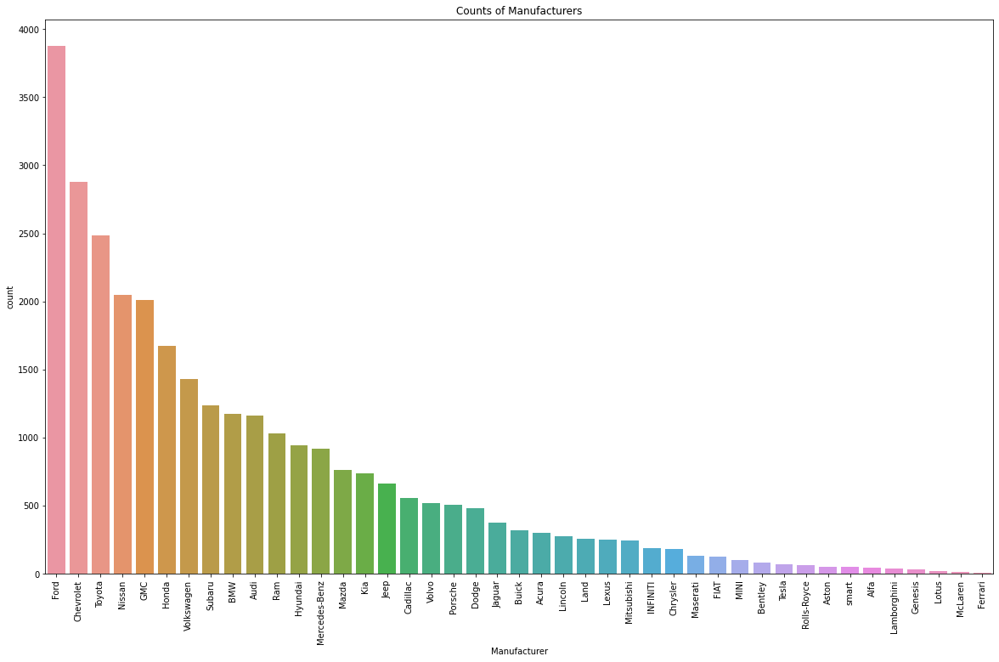

In [ ]:
plt.figure(figsize=(20, 12))
g = sns.countplot(data=df_cleaning, x='Manufacturer',order=df_cleaning['Manufacturer'].value_counts().index)
g.set_title('Counts of Manufacturers')
plt.xticks(rotation=90)

The manufacturer with most cars in this dataset are Ford, Cheverolet, and Toyota. While luxury and high performance brands are less represented such as Ferrair and McClaren. The more models a manufactuer has, the more often their brand is represented in the dataset.

#### Manufacturer

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42]),
 <a list of 43 Text major ticklabel objects>)

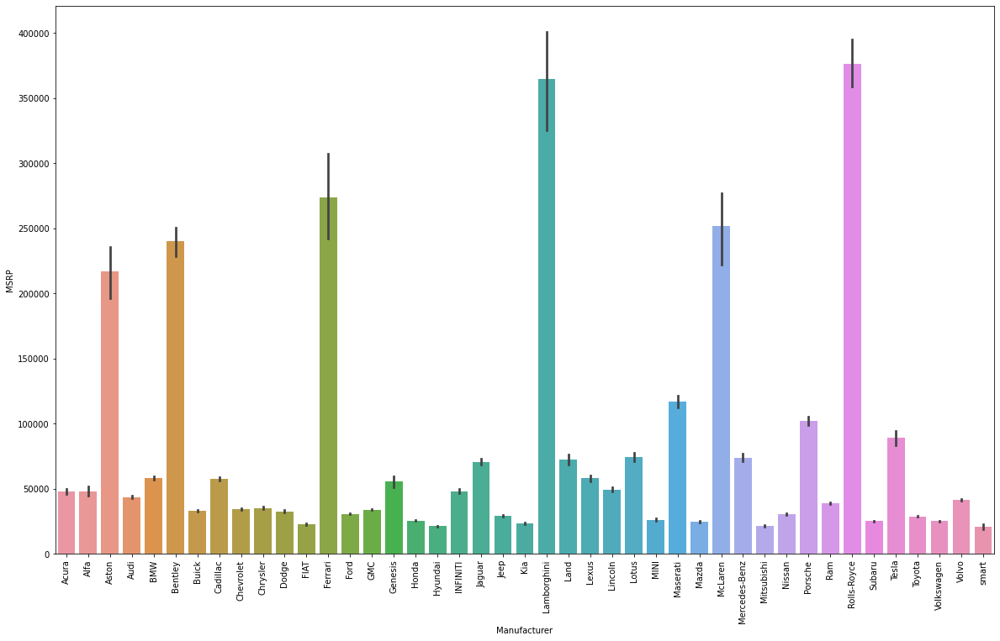

In [ ]:
plt.figure(figsize=(20,12))
g = sns.barplot(data=df_cleaning, x = 'Manufacturer', y = 'MSRP', order = df_cleaning.groupby(by='Manufacturer')['MSRP'].mean().index)
plt.xticks(rotation=90)

Generally, the brand will make a difference in the average MSRP. From looking at the graph, we can see that brands that are considered more luxury (Maserati, Porsche) are more expensive, while brands that are considered economical(Ford, Hyundai) are less expensive. While high performance cars such as Ferrai and Lamborghini as much more expensive than others. The brand should prove useful in our regressions.

#### Year

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22]), <a list of 23 Text major ticklabel objects>)

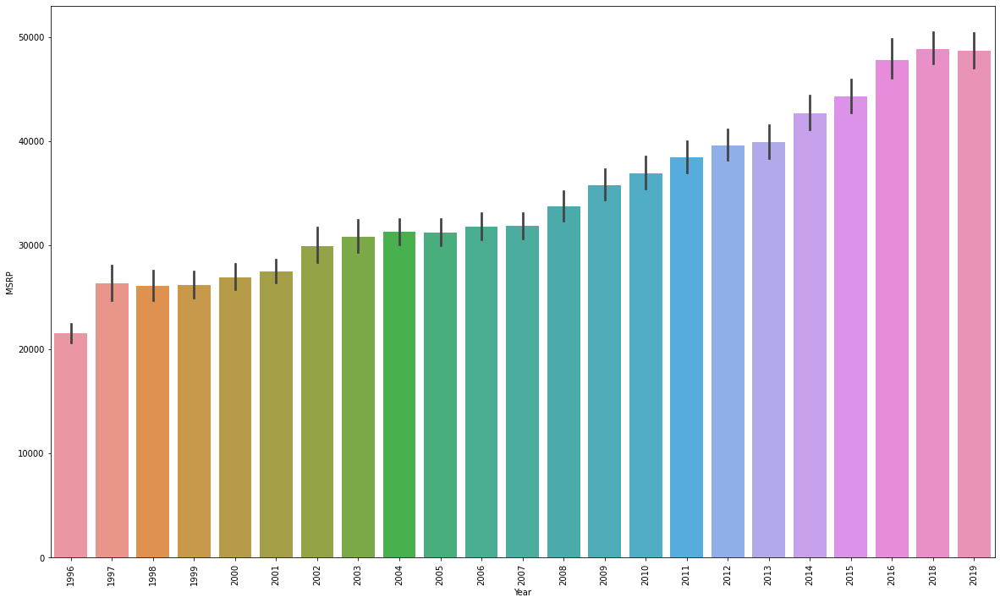

In [ ]:
plt.figure(figsize=(20,12))
g = sns.barplot(data=df_cleaning, x = 'Year', y = 'MSRP', order = df_cleaning.groupby(by='Year')['MSRP'].mean().index)
plt.xticks(rotation=90)

From the graph, we can see that the as the car gets newer, the average MSRP of that year rises as well. The youngest instance from 1996 is, on average, the cheapest, while the cars from 2019 are, on average, the most expensive.

### EPA Fuel Economy Est - City (MPG)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51]), <a list of 52 Text major ticklabel objects>)

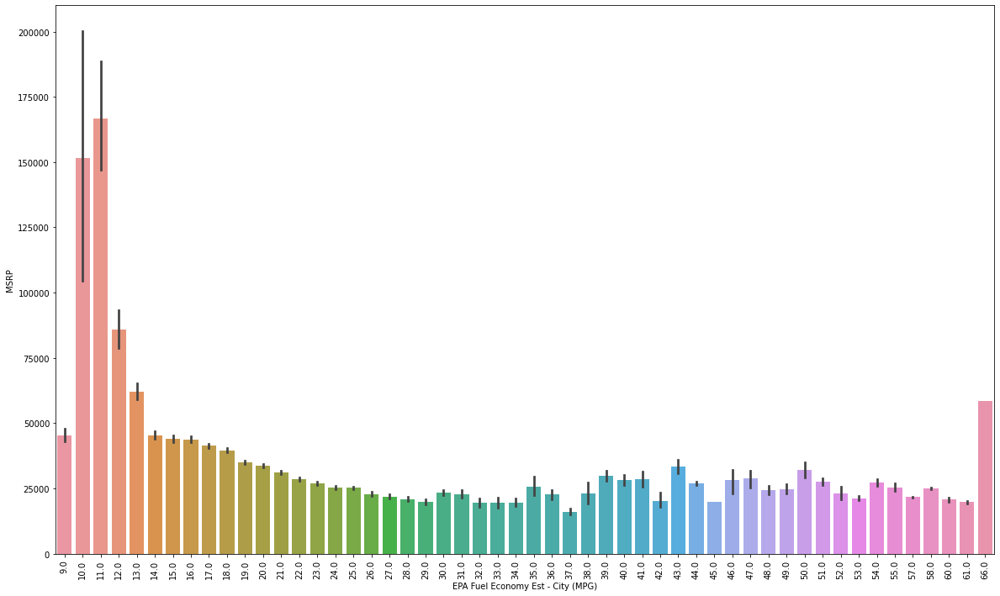

In [ ]:
plt.figure(figsize=(20,12))
g = sns.barplot(data=df_cleaning, x = 'EPA Fuel Economy Est - City (MPG)', y = 'MSRP', order = df_cleaning.groupby(by='EPA Fuel Economy Est - City (MPG)')['MSRP'].mean().index)
plt.xticks(rotation=90)

From the graph, we can see that as MPG increases there is a average decrease in price until around 35 MPG (city). From there, the average price increases slightly and varies largely until 61 MPG (city). This high MSRP at the beginning makes sense, as with more expensive cars such as Rolls Royce's and Ferrari's, they have very poor gas mileage (low 10s) and a very high MSRP. While more affordable cars usually has gas mileage in the 20s and 30s, that everyday people can afford. This feature should be useful in our models.

### Engine

Currently, the engine feature is represented in the form of 'Turbo Premium Unleaded I-4, 2.0 L.' This information is highly unique to each feature, and if we attempted to one-hot-encode this feature, I am going to add way too many columns, as there are 400 unique engines in the feature. To reduce the scope of the engine feature, I am going to extract the 'I-4,' which is the engine configuration, and the '2.0L,'

In [ ]:
num_unique = len(df_cleaning['Engine'].unique())
print("There are {} unique engines in the 'Engine' feature".format(num_unique))

There are 451 unique engines in the 'Engine' feature


In [ ]:
df_cleaning['engine_cyl'], df_cleaning['engine_liters'] = df_cleaning['Engine'].str.split(",").str[0].str.split(" ").str[-1], df_cleaning['Engine'].str.split(",").str[1].str.replace(" ","")

In [ ]:
df_cleaning['engine_liters'] = df_cleaning['engine_liters'].str.strip("L").str.strip("l")

In [ ]:
df_cleaning = df_cleaning.drop('Engine',axis=1)

#### Engine Cylinders

I have created a table of the unique values in the 'engine_cyl' feature. There a few issues with the current values in this feature; many of the values are repeated in different formats such as "I-6" and "I6." Additionally, in other values, we have different capitalization of the same value such as "4-cyl" and "4-Cyl." We will need to correct this issues to reduce the scope of this feature when we create dummy variables.

In [ ]:
unique = df_cleaning['engine_cyl'].unique()

In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['Unique','Unique','Unique','Unique']),
                               cells=dict(values=[unique[:10], unique[10:20], unique[20:30],unique[30:]]))])
fig.show()

In [ ]:
df_cleaning['engine_cyl'] = df_cleaning['engine_cyl'].str.replace("-","")

In [ ]:
df_cleaning['engine_cyl'] = df_cleaning['engine_cyl'].replace({'i4': 'I4'})

In [ ]:
df_cleaning['engine_cyl'] = df_cleaning['engine_cyl'].replace(['I4', 'L4', 'l4', '4Cyl', 'l4', '4cyl', '4'], 'l4')

In [ ]:
df_cleaning['engine_cyl'] = df_cleaning['engine_cyl'].replace(['6Cyl','6cyl','6'], 'V6')

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20]), <a list of 21 Text major ticklabel objects>)

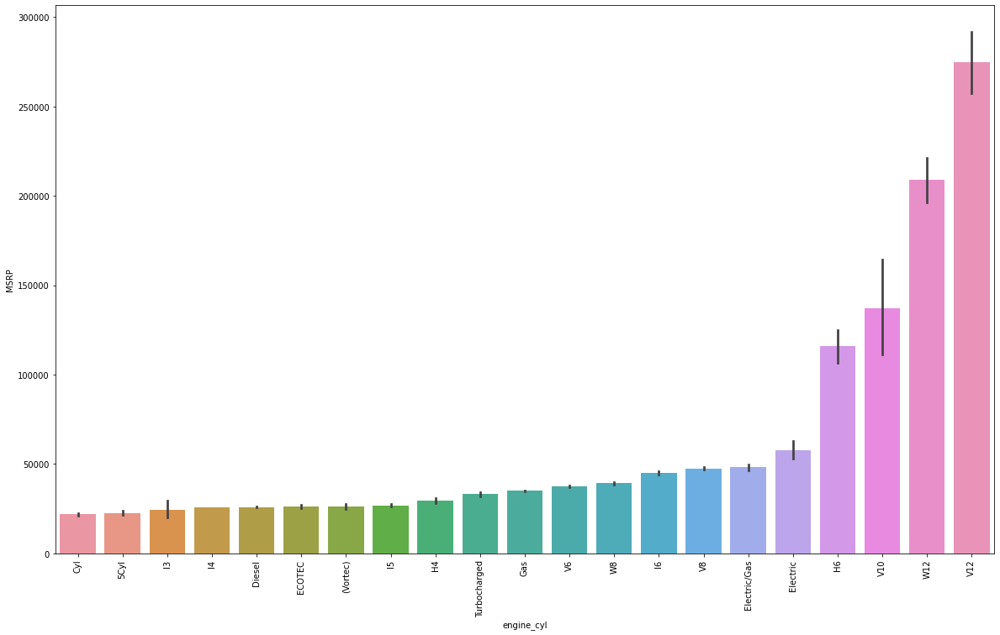

In [ ]:
plt.figure(figsize=(20,12))
sns.barplot(data=df_cleaning, x = 'engine_cyl', y = 'MSRP', order = df_cleaning.groupby(by='engine_cyl')['MSRP'].mean().sort_values(ascending=True).index)
plt.xticks(rotation=90)

As the engine gets more cylinders/ more powerful, the MSRP increases accordingly, a 4-cylinder engine is, on average, the cheapest, while the V12 is the most expensive. Again, more affordable cars for everyday people usually only have 4 cylinders or 6 cylinders, while high end performance cars have v12s and v10s, which exponetially raise the MSRP of the cars.

#### Engine Liters

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59]),
 <a list of 60 Text major ticklabel objects>)

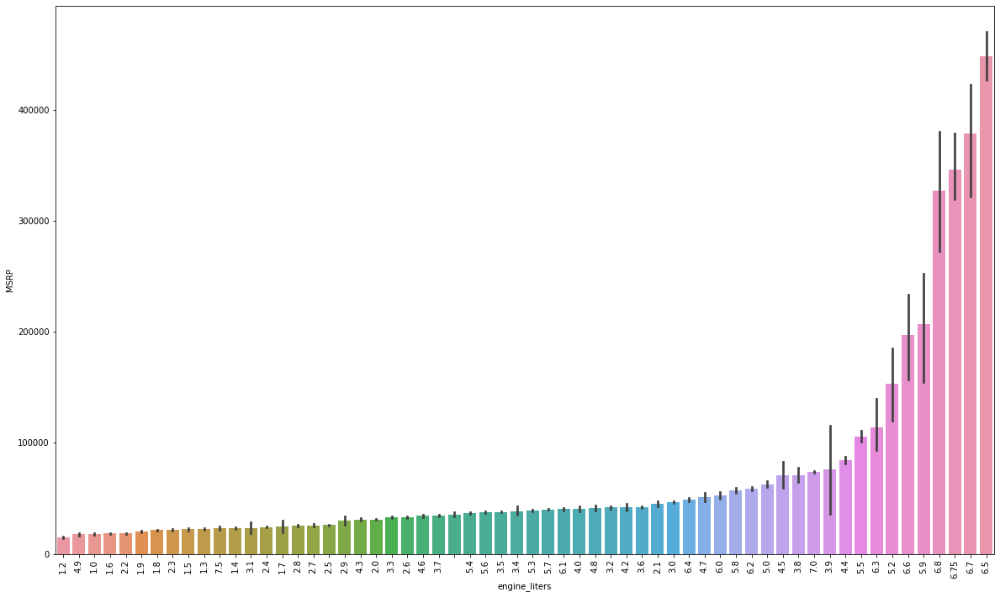

In [ ]:
plt.figure(figsize=(20,12))
sns.barplot(data=df_cleaning, x = 'engine_liters', y = 'MSRP', order = df_cleaning.groupby(by='engine_liters')['MSRP'].mean().sort_values(ascending=True).index)
plt.xticks(rotation=90)

From the graph, we can see that there are plenty of different levels of engine displacement with each of their own levels of MSRP. Although, there is a large range of MSRP prices for a few of the engine liters such as 6.8, 6.75 and 6.7, the rest of the engine liters should prove useful for determining MSRP. Also, in general, it seems that the more an engine can displace, the more expensive the MSRP becomes.

In [ ]:
df_cleaning['engine_liters'] = df_cleaning['engine_liters'].str.strip("L").str.strip("l")

In [ ]:
df_cleaning['engine_liters'] = pd.to_numeric(df_cleaning['engine_liters'])

### EPA Clasification

From looking at the data of EPA Classification, we can see that it contains information that tells you if the vehicle is AWD, 2WD and the body style of the car. The good news is that this information is in other features. The 'drivetrain' feature tells us if the car is Front Wheel Drive or All Wheel Drive and the 'Body Style' tells us the style of the car. The 'EPA Classification' feature shows values that are already in other features, which makes it redundent. We can drop this feature from the dataset.

In [ ]:
epa = df_cleaning['EPA Classification'][:10]
drive = df_cleaning['Drivetrain'][:10]
body = df_cleaning['Body Style'][:10]

In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['EPA Classification', 'Drivetrain', 'Body Style']),
                               cells=dict(values=[epa, drive, body]))])
fig.show()

In [ ]:
df_cleaning = df_cleaning.drop("EPA Classification", axis=1)

### Body Style

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23]),
 <a list of 24 Text major ticklabel objects>)

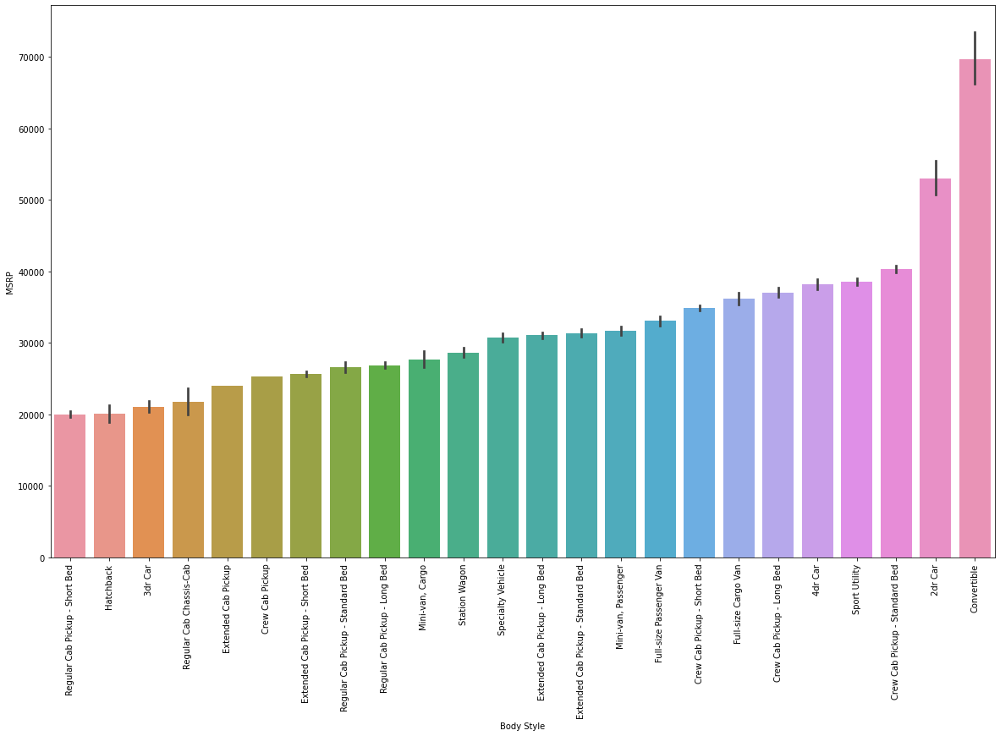

In [ ]:
plt.figure(figsize=(20,12))
sns.barplot(data=df_cleaning, x = 'Body Style', y = 'MSRP', order = df_cleaning.groupby(by='Body Style')['MSRP'].mean().sort_values(ascending=True).index)
plt.xticks(rotation=90)

Each body style of the cars has a different average MSRP. When we dummy encode this features and apply a variance threshold across these dummy variables, many of these may be dropped, and its significance may drop. Oveall, I don't think this feature will be the most significant in the model.

### Style Name

This feature tells us redundant information. For example, one instance is 'FWD w/ Technology Pkg' and another is '4dr Wgn T5 AWD.' This information is already in other features. The number of doors is represented in the feature 'Passenger Doors,' and its drive train (FWD or AWD) is represented in the 'Drivetrain' feature. This allows us to drop the 'Style Name' feature from the dataset.

In [ ]:
style = df_cleaning['Style Name'][-10:]
doors = df_cleaning['Passenger Doors'][-10:]
drive = df_cleaning['Drivetrain'][-10:]

In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['Style Name', 'Doors', 'Drivetrain']),
                               cells=dict(values=[style, doors, drive]))])
fig.show()

In [ ]:
df_cleaning = df_cleaning.drop('Style Name', axis=1)

### Drive Train

In its current shape, there a lot of unique values, however, these unique values are just spelled differently. For example, there are multiple instances of "Front Wheel Drive," and some have values like "Front-wheel drive" and "Front wheel drive." They all have the same meaning, but we need to correct them so there aren't any repeats.

In [ ]:
df_cleaning['Drivetrain'] = df_cleaning['Drivetrain'].replace(['Front Wheel Drive', 'Front-Wheel Drive', '2WD',
                                                               'Front wheel drive', 'Front-wheel drive', '2-Wheel Drive',
                                                               '2 Wheel Drive'], 'FWD')

In [ ]:
df_cleaning['Drivetrain'] = df_cleaning['Drivetrain'].replace(['All Wheel Drive','All-Wheel Drive',
                                                               'All wheel drive', 'All-wheel drive', 'AWD',
                                                               ], 'AWD')

In [ ]:
df_cleaning['Drivetrain'] = df_cleaning['Drivetrain'].replace(['Rear Wheel Drive', 'RWD', 'REAR WHEEL DRIVE',
                                                               'Rear wheel drive', 'Rear-Wheel Drive', 
                                                               ], 'RWD')

In [ ]:
df_cleaning['Drivetrain'] = df_cleaning['Drivetrain'].replace(['4 Wheel Drive', 'Four Wheel Drive', '4-Wheel Drive',
                                                               '4WD', 'Four-Wheel Drive','Four wheel drive', '4-wheel Drive'
                                                               ], '4WD')

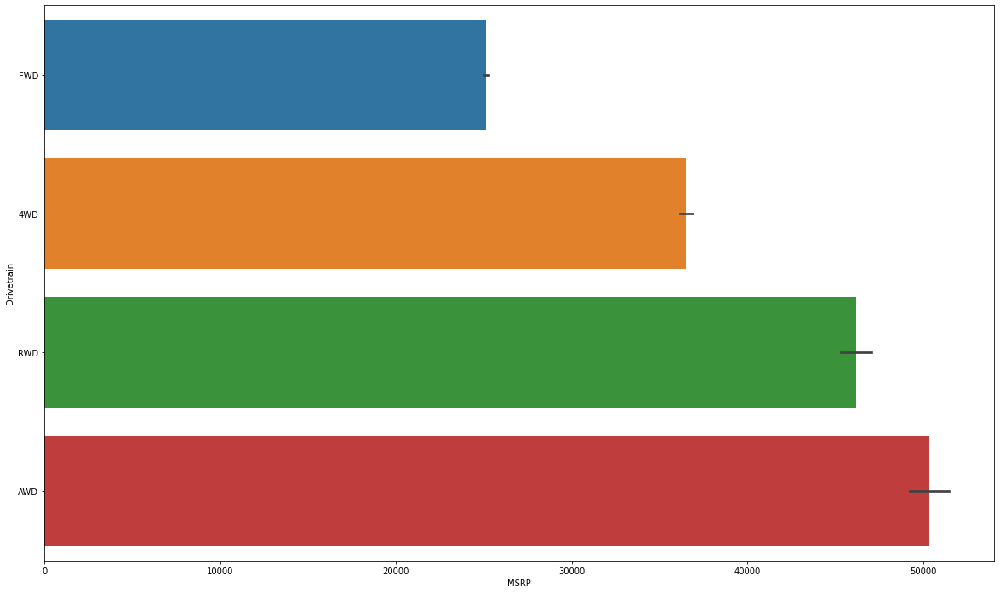

In [ ]:
plt.figure(figsize=(20,12))
sns.barplot(data=df_cleaning, x = 'MSRP', y = 'Drivetrain', order = df_cleaning.groupby(by='Drivetrain')['MSRP'].mean().sort_values(ascending=True).index)

From the barplot, we can see that Front Wheel Drive cars are the cheaper ones, on average, while 4WD, RWD and AWD are more expensive. This makes sense since more affordable cars are more likely to have FWD like Toyota Camry's and Honda Accord's, while cars with AWD can be made by affordable manufactuer's but their price is likely to go up because AWD is more expensive to make. Lastly, RWD cars are more likely to be sports cars and more luxury cars, which increases the price of the car because of better performance.

### Passenger Capacity

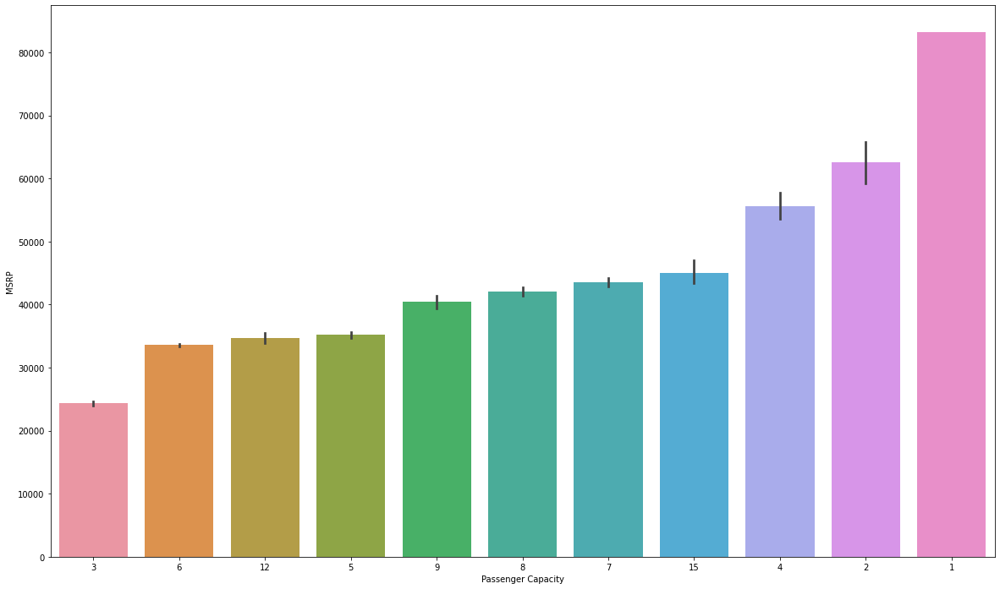

In [ ]:
plt.figure(figsize=(20,12))
sns.barplot(data=df_cleaning, x = 'Passenger Capacity', y = 'MSRP', order = df_cleaning.groupby(by='Passenger Capacity')['MSRP'].mean().sort_values(ascending=True).index)

There doesn't seem to be much difference in the price based on the number of people it can hold. However, it general those with more seats tend to more expensive, but it is not a hard fact at all. At the end of the spectrum, there is a one person car, which is the most expensive car albeit with only one seat. Additionally, the average MSRP for 2 people cars and 4 people cars are high, as well because of cars like Ferrari's, Aston Martin's and Lamborghini's have two people cars and four people cars which most likely raise the average MSRP of these values. Overall, this feature should be helpful for our models.

### Passenger Doors

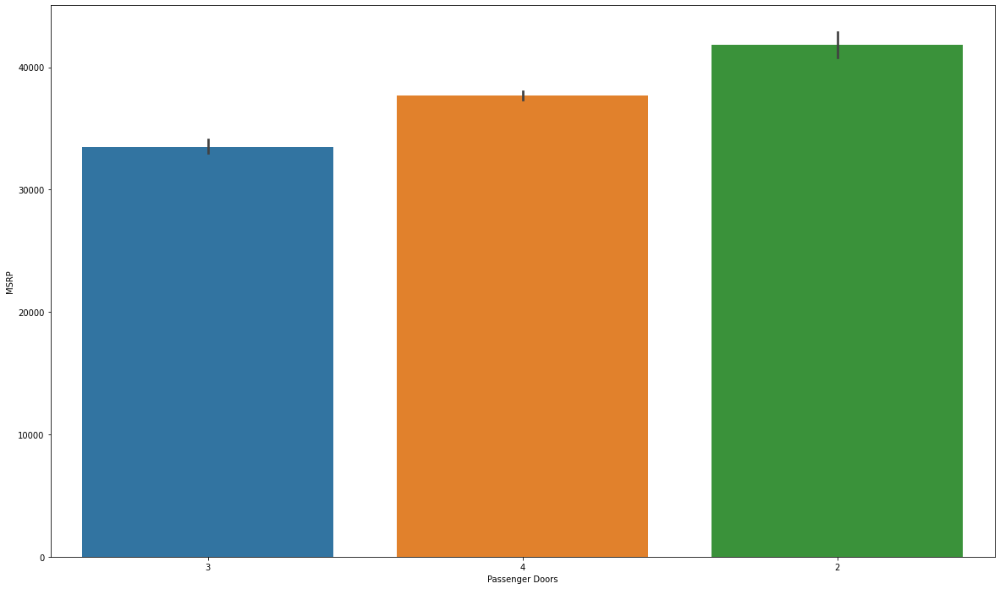

In [ ]:
plt.figure(figsize=(20,12))
sns.barplot(data=df_cleaning, x = 'Passenger Doors', y = 'MSRP', order = df_cleaning.groupby(by='Passenger Doors')['MSRP'].mean().sort_values(ascending=True).index)

As the number of doors increase on a car, the MSRP, on average, increase slightly. However, they are the average prices for each number of doors are roughly the same, thus this may make an impact on the accuracy of our models. But, I think it will be a slight impact, but nonetheless be somewhat helpful in our models.

### Body Style

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23]),
 <a list of 24 Text major ticklabel objects>)

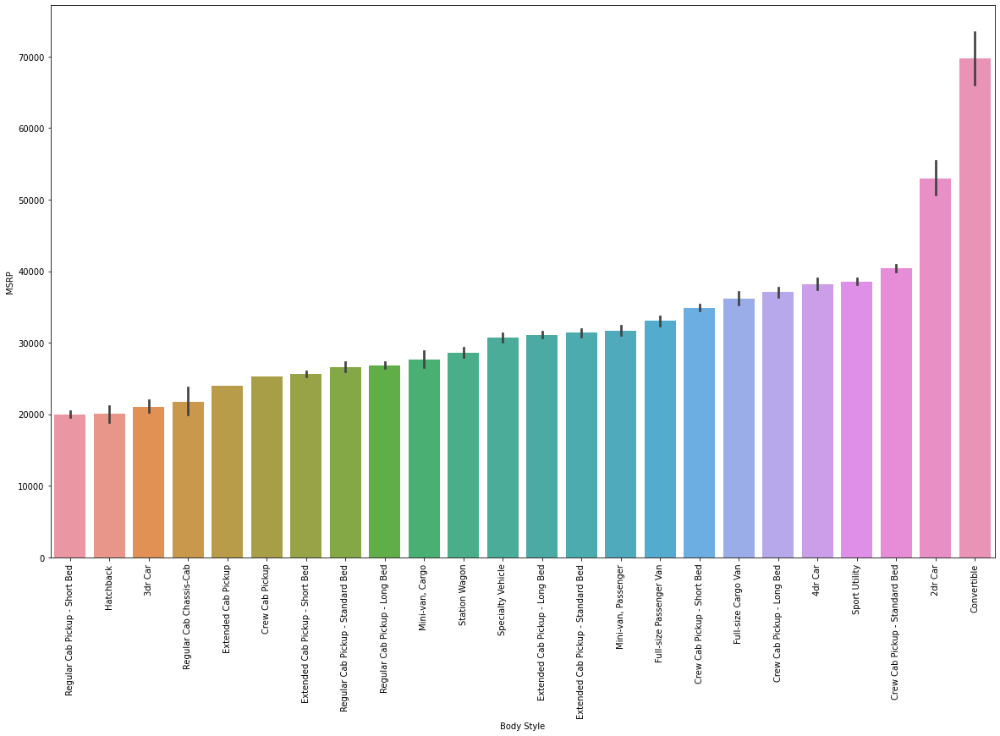

In [ ]:
plt.figure(figsize=(20,12))
sns.barplot(data=df_cleaning, x = 'Body Style', y = 'MSRP', order = df_cleaning.groupby(by='Body Style')['MSRP'].mean().sort_values(ascending=True).index)
plt.xticks(rotation=90)

Each body style of a vehicle has a relatively different average MSRP. Depending of the type of vehicle, and if the dummy variable has enough variance, then this could have some impact on our model.

### Transmission

This is another feature we can drop. An instance of this feature is 'Transmission: 10-Speed Automatic -inc: sequential SportShift paddle shifters.' This information is inside of others features. The 10-speed is represented in the "Trans Type" feature, "10.0" correspondingly. And the "Automatic" is represented in the "Trans Description Cont." feature which is "Automatic w/OD" for this instance. Therefore, I do not believe we need to keep the "Transmission" feature, thus it will be dropped.

In [ ]:
trans = df_cleaning['Transmission'][:10]
type1 = df_cleaning['Trans Type'][:10]
trans_desc = df_cleaning['Trans Description Cont.'][:10]

In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['Transmission', 'Trans Type', 'Description']),
                               cells=dict(values=[trans, type1, trans_desc]))])
fig.show()

In [ ]:
df_cleaning = df_cleaning.drop("Transmission", axis=1)

### Base Curb Weight (lbs)

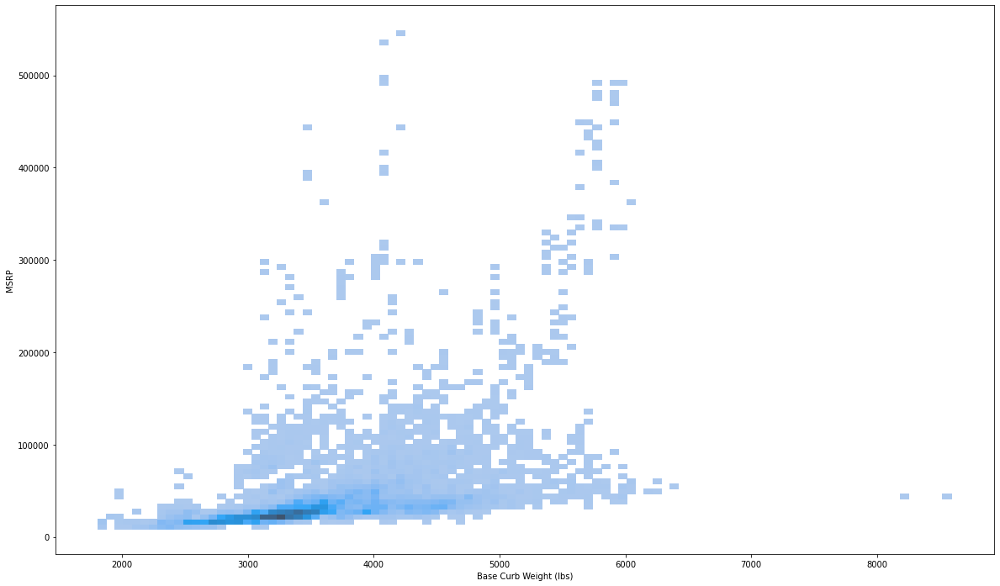

In [ ]:
plt.figure(figsize=(20,12))
sns.histplot(data=df_cleaning, x='Base Curb Weight (lbs)', y='MSRP', bins = 100)

From the graph, we can see that as the Base Curb Weight increases, the price increase as well, albeit very slightly. This may have a slight impact on our model.

### Passenger Volume (ft^3)

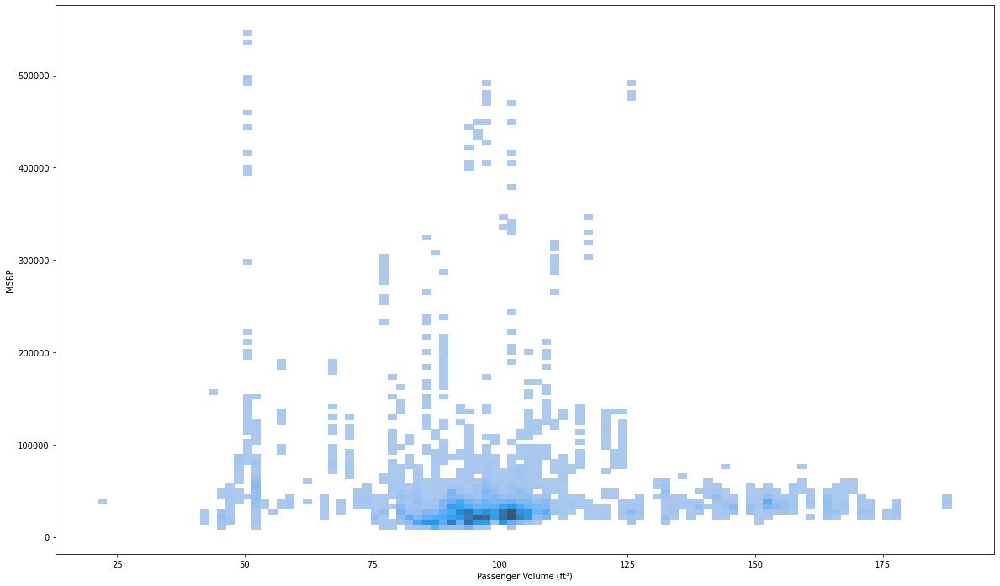

In [ ]:
plt.figure(figsize=(20,12))
sns.histplot(data=df_cleaning, x='Passenger Volume (ft³)', y='MSRP', bins = 100)

Keeping our eye on the dark blue patch of rectangles in the middle of the graph, we see that as passenger volume increase, the MSRP increases, as well. This feature should be helpful in some instances, but there seems to be a lot of variation in this data for each value of "Passenger Volume," so I don't believe it will be strong predictor of MSRP.

### Wheelbase (in)

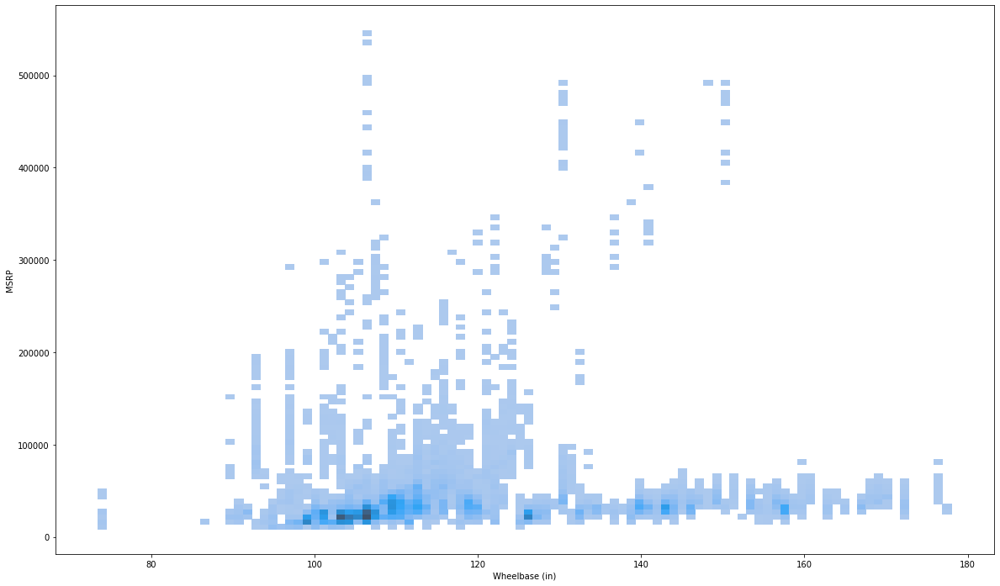

In [ ]:
plt.figure(figsize=(20,12))
sns.histplot(data=df_cleaning, x='Wheelbase (in)', y='MSRP', bins = 100)

From the graph, we can see a slight positve correlation between wheelbase and MSRP. As the wheelbase gets larger, the range of prices tends to have a higher low and higher high. I think this be useful in our models, but its impact may be marginal.

### Track Width, Front (in)

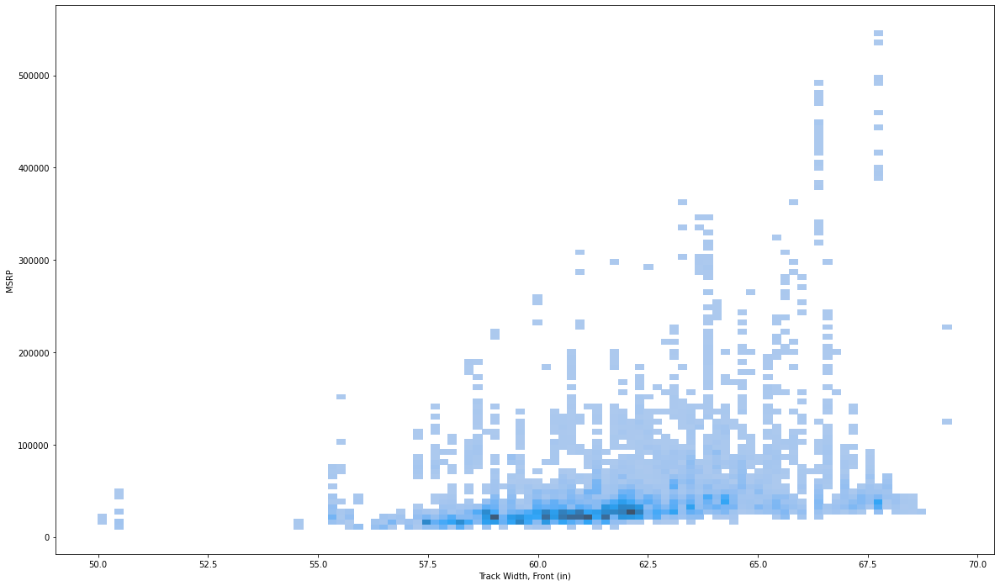

In [ ]:
plt.figure(figsize=(20,12))
sns.histplot(data=df_cleaning, x='Track Width, Front (in)', y='MSRP', bins = 100)

In this graph, there is a very slight positive correlation between increasing "Track Width, Front (in)", but we can see that the range of prices grows larger as the track width increases in size. This may be helpful in our model, but the impact will be slight.

### Height, Overall (in)

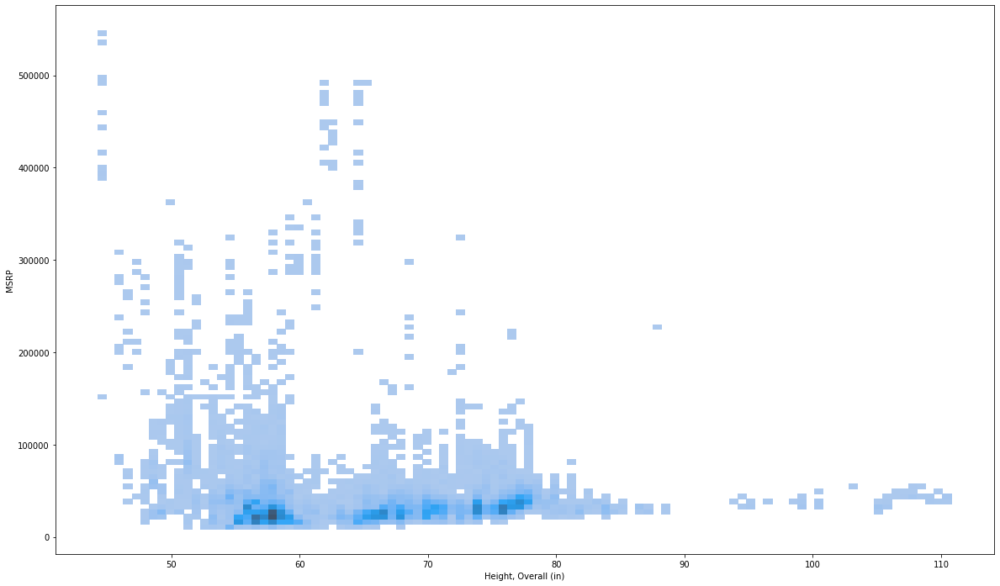

In [ ]:
plt.figure(figsize=(20,12))
sns.histplot(data=df_cleaning, x='Height, Overall (in)', y='MSRP', bins = 100)

There seems to be almost no correlation between a cars height and MSRP. As it increases, the MSRP stays pretty consistent as if you drew an imaginary line through the data. I don't think this will be particurly useful in our models.

### Fuel Tank Capacity, Approx (gal)

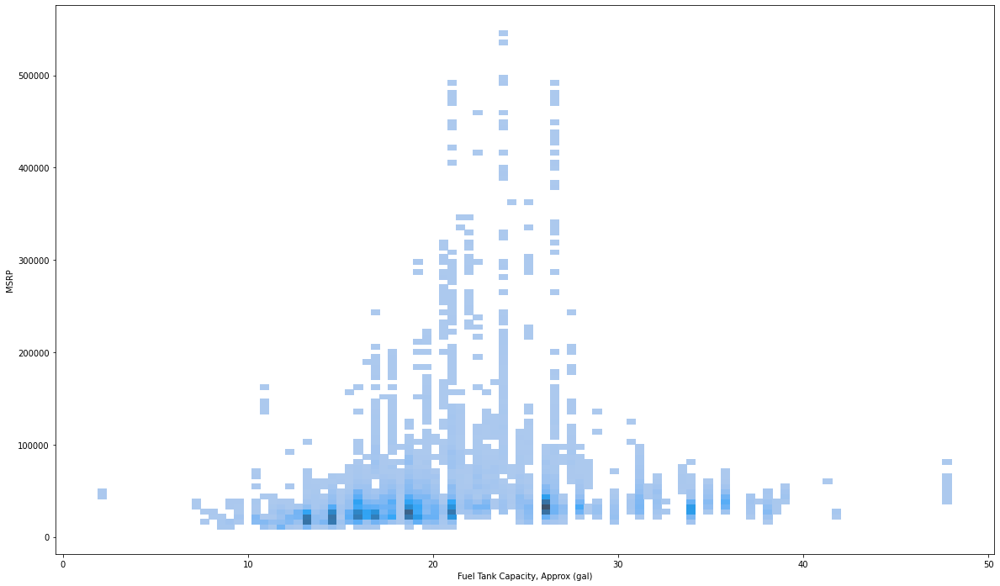

In [ ]:
plt.figure(figsize=(20,12))
sns.histplot(data=df_cleaning, x='Fuel Tank Capacity, Approx (gal)', y='MSRP', bins = 100, kde=True)

From the graph, there doesn't seem to be any type of correlation between the amount of gas a car can hold and its MSRP. There might be a slight positive correlation between these features, but in general, as it gets larger, the range of prices grows larger. I don't think the impact of this feature will be large on the models.

### SAE Net Torque @ RPM

I am editing this feature to remove the RPM aspect, because it measures Revolution per Minute which is measuring how fast the engine is operating. However, the Net Torque is the measure of performance from the engine, which I beleive is more important in predicting MSRP price, as cars with more torque are more expensive, in general.

In [ ]:
df_cleaning['net_torque'] = df_cleaning['SAE Net Torque @ RPM'].str.split(" ").str[0]
df_cleaning['net_torque'] = pd.to_numeric(df_cleaning['net_torque'])
df_cleaning = df_cleaning.drop('SAE Net Torque @ RPM', axis=1)

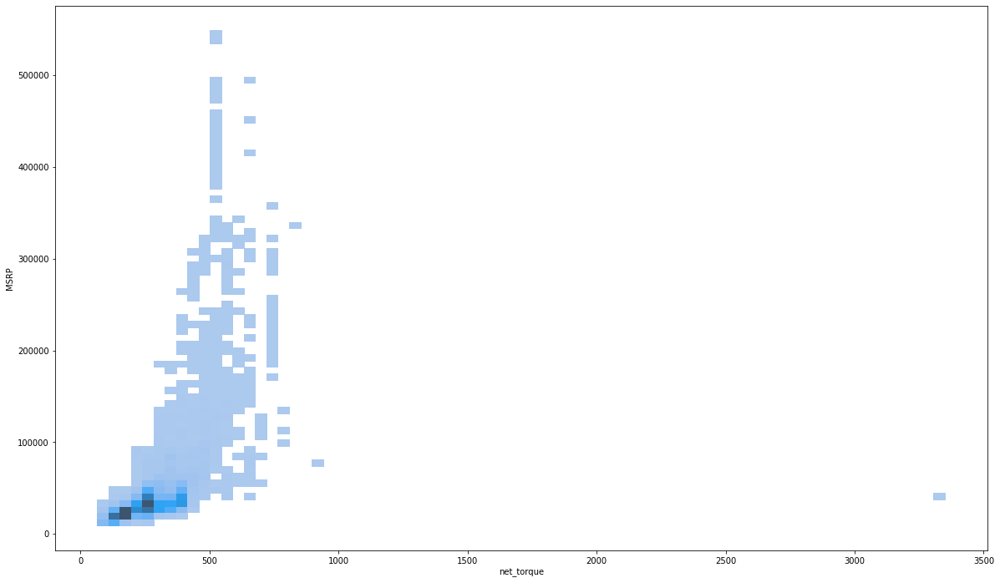

In [ ]:
plt.figure(figsize=(20,12))
sns.histplot(data=df_cleaning, x='net_torque', y='MSRP', bins = 75, kde=True)

From the graph, we can see a strong correlation between increasing net torque and MSRP. as net torque increase, the MSRP rise as well at fast rate. This should be helpful in our regression.

### Fuel System

In order to reduce feature dimensions, I have replaced the different types of fuel systems into three categories, Direct Injection (Direct), Sequential Fuel Injection (SFI) and Electronic Injection (EI).

In [ ]:
df_cleaning['Fuel System'].unique()

array(['Direct', 'SFI', 'EI', nan], dtype=object)

In [ ]:
df_cleaning['Fuel System'] = df_cleaning['Fuel System'].replace(['Gasoline Direct Injection', 'Direct Injection', 'DI',
                                                                 'Diesel Direct Injection', 'FSI', 'Direct injection', 'Direct',
                                                                 'TDI', 'SDI', ' FSI Direct', 'TFSI Direct', 'DOHC FSI Direct',
                                                                 'TFSI', 'GDI', 'HPI', 'FI', 'SIDI', 'Direct Gasoline Injection',
                                                                 'PFI', 'Turbo-Charged DI', 'Turbo-Charged DI', 'Turbo-Charged OHV',
                                                                 'DIS', 'DISI', 'CRD', 'CDI', 'NDIS', 'Turbocharged DI',
                                                                 'Turbocharged', 'Turbocharged FSI', 'Turbo-Diesel', 'Port/Direct Injection'
                                                                 ,'MPFI','FSI Direct', 'SMFI'], 'Direct')

In [ ]:
df_cleaning['Fuel System'] = df_cleaning['Fuel System'].replace(['Sequential MPI', 'MPI', 'SEFI', 'SI', 'SMPI', 'SFI',
                                                                 'Sequential MPI (injection)', 'MFI', 'Sequential Fuel Injection',
                                                                 'SFI FlexFuel', 'SPFI', 'SPI', 'Supercharged SPFI', 'SFI/DI',
                                                                 'SMPFI', 'Turbocharged SMPI'], 'SFI')

In [ ]:
df_cleaning['Fuel System'] = df_cleaning['Fuel System'].replace(['Electronic Fuel Injection', 'PGM-FI',
       'PGM-FI MPI', 'EFI', 'Electronic fuel injection', 'Electric',
       'Hydrogen', 'Supercharged EFI', 'EMPI',
       'Electronic Fuel Injectino', 'Turbocharged EMFI',
       'Turbocharged EFI', 'FFV'], 'EI')

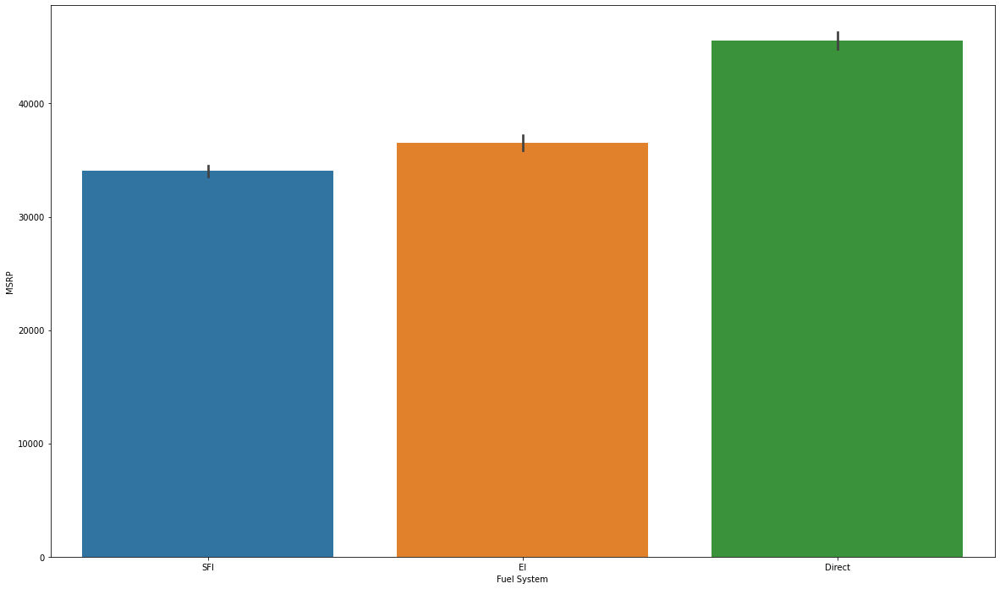

In [ ]:
plt.figure(figsize=(20,12))
sns.barplot(data=df_cleaning, x = 'Fuel System', y = 'MSRP', order = df_cleaning.groupby(by='Fuel System')['MSRP'].mean().sort_values(ascending=True).index)

Each type of engine has a different average MSRP, with Direct Injection engines being the most expensive and Sequential Fuel Injection engines being the least expesive, and the Electronic injections being in the middle. I think this information will be slightly useful for the models.

### SAE Net Horsepower @ RPM

Again, like in the SAE Net Torque category I removed the RPM aspect of the value because the Net Horsepower, itself, is a better representative indicator of performance for a car. And, in general, when Horsepower increases, the MSRP increase, as well.

In [ ]:
df_cleaning['net_hp'] = df_cleaning['SAE Net Horsepower @ RPM'].str.split(" ").str[0]
df_cleaning['net_hp'] = pd.to_numeric(df_cleaning['net_torque'])
df_cleaning = df_cleaning.drop('SAE Net Horsepower @ RPM', axis=1)

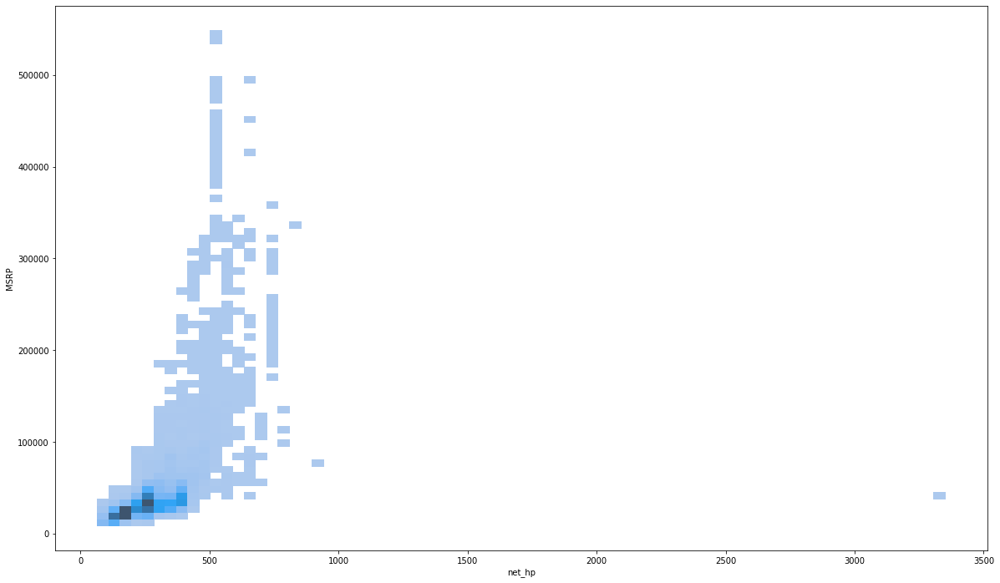

In [ ]:
plt.figure(figsize=(20,12))
sns.histplot(data=df_cleaning, x='net_hp', y='MSRP', bins = 75, kde=True)

We can see that as Net Horsepower increases, the MSRP increases at a fast rate. This makes sense as more powerful cars are more expensive. The Net Horsepower feature should be useful in our regression.

### Displacement

We can drop this feature because we already extracted the displacement by the engine from the "Engine" feature, we where took out the liters of displacement for each engine, thus we can drop this feature.

In [ ]:
dis = df_cleaning['Displacement'][:10]
liters = df_cleaning['engine_liters'][:10]

In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['Displacement', 'Liters']),
                               cells=dict(values=[dis, liters]))])
fig.show()

In [ ]:
df_cleaning = df_cleaning.drop('Displacement', axis=1)

### Trans Description Cont.

Since many of the unique values in this feature have the same transmission, I am going to attempt to reduce the 58 unique values into "Automatic" and "Manual," the two standard type of transmissions in cars.

In [ ]:
df_cleaning['Trans Description Cont.'] = df_cleaning['Trans Description Cont.'].replace(['Automatic w/OD', 'Automatic w/Manual Shift', 'Automatic',
                                                                                         'Automatic w/OD,', 'CVT w/OD', 'Continuously Variable Ratio',
                                                                                         'Sportshift Automatic', 'Automatic w/manual shift',
                                                                                         'Automatic CVT', 'CVT Automatic w/OD', 'Automatic w/Manual Transmission', 'CVT', 'Tiptronic',
                                                                                         'Automatic,', 'CVT Automatic', 'S tronic Automatic w/OD',
                                                                                         'DSG Automatic w/OD', 'Direct Shift Automatic', 'SMG', 'HD Automatic w/OD',
                                                                                         'automatic w/OD', 'HD Automatic w/OD,', 'HD Automatic', 'HD',
                                                                                         'Continuously Variable Transmission', 'Multi-Speed Automatic w/OD',
                                                                                         'Continuously variable ratio', 'Auto w/OD', 'HD Auto w/OD', 'Electronic', 'HD Electronic',
                                                                                         'Automatic w/SHIFTRONIC, OD', ' Automatic w/OD', 'Automatic w/CommandShift', 'Automatic/CVT w/OD', 'ECVT',
                                                                                         'Electronic automatic', 'Automatic w/AMG Speedshift', 'Auto',
                                                                                         'Sportronic Auto w/OD', 'Continuously Variable', 'Continuously variable', 'Automatic w/manual mode',
                                                                                         'Continously Variable', 'PDK Automatic', 'Automatic, Sportshift', 'Automatic w/OD, Sportshift'], "Auto")

In [ ]:
df_cleaning['Trans Description Cont.'] = df_cleaning['Trans Description Cont.'].replace(['Auto-Shift Manual w/OD', 'Manual w/OD', 'Manual',
                                                                                         'Manual w/OD,', 'Sequential Manual', 'manual w/OD',
                                                                                         'HD Manual w/OD', 'HD Manual w/OD,', 'HD Manual', 'Manual W/OD',
                                                                                         'DSG', 'DSG w/OD'],"Manual")

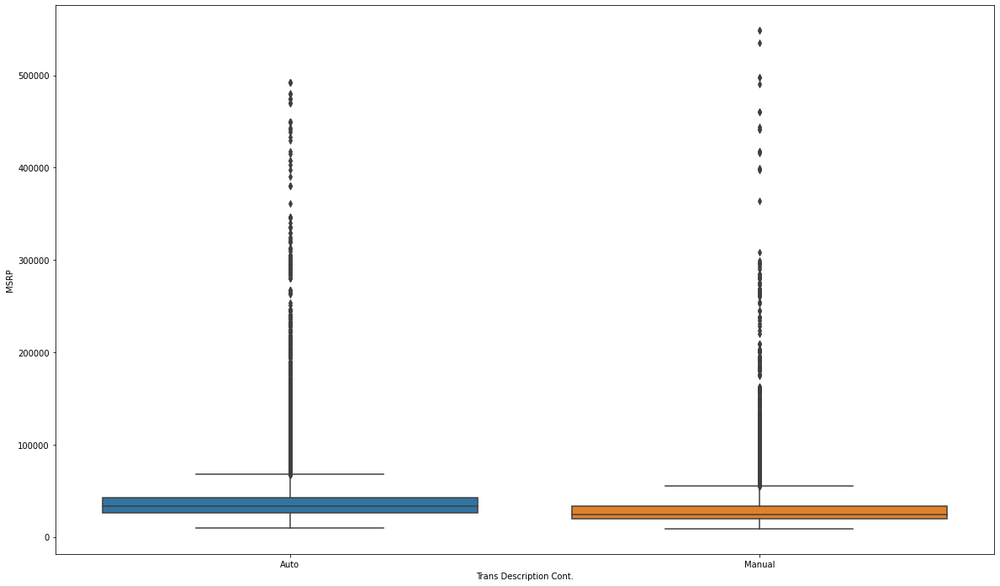

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Trans Description Cont.', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Trans Description Cont.")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Trans Description Cont.,,,,,,,,
Auto,22699.0,39968.849289,30760.752157,9770.0,26325.0,33270.0,42802.5,492425.0
Manual,7526.0,34410.965453,36966.084550,8599.0,19215.0,24300.0,33600.0,548800.0


Automatic Cars are, on average, more expensive than Manual cars, but manual cars have the highest priced car. I think the average MSRP for automatic cars is high because of the inclusion of supercars, as many of these cars are automatic at a premium price raising the average MSRP for these cars. Although, there are still expensive cars that still have a manual transmission that which is why it is higher than the Automatic, and often, Manual supercars are more often sought after.

### Trans Type

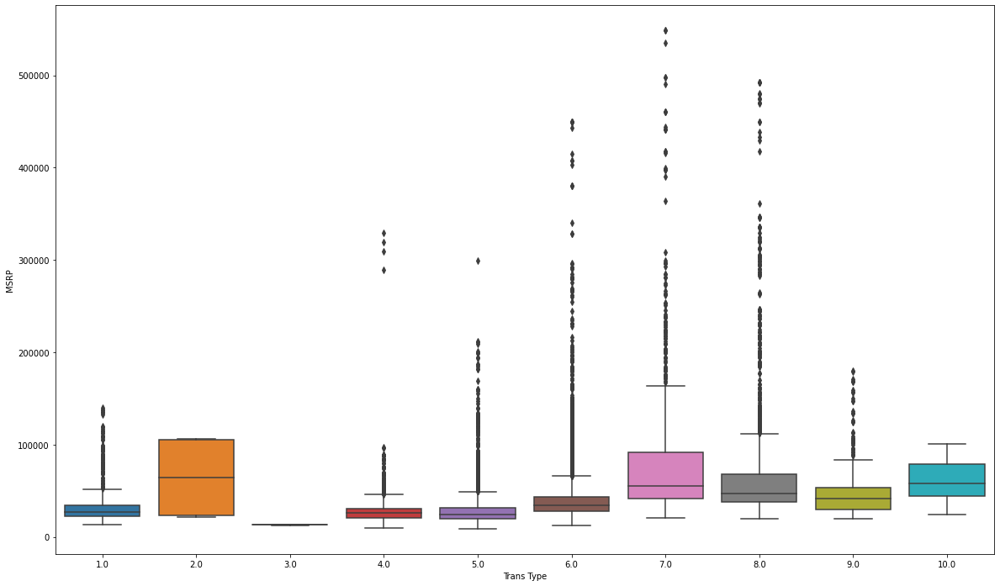

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Trans Type', y='MSRP')

As the transmission has more speeds, the MSRP of the car increase as, well, although there are many outliers in the data for many of the lower speeds, the average generally rises as the amount of speeds the transmission has. This should be useful in our regression.

### Brake Type

In [ ]:
df_cleaning['Brake Type'] =df_cleaning['Brake Type'].replace(['Pwr','pwr','Pwr Assisted','Pwr-assisted'],'Power')

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 <a list of 13 Text major ticklabel objects>)

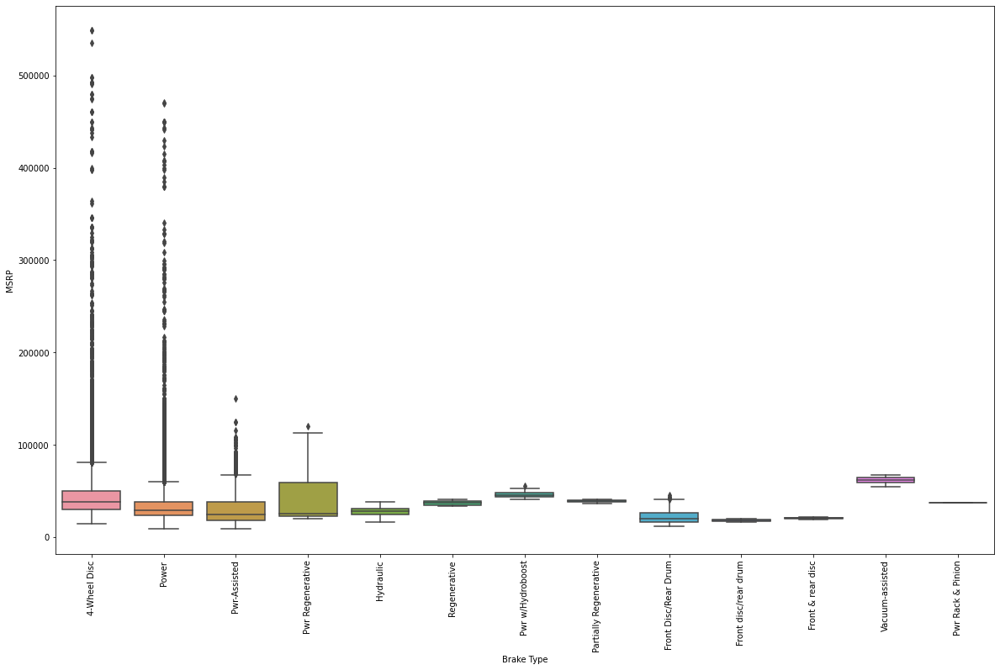

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Brake Type', y='MSRP')
plt.xticks(rotation=90)

In [ ]:
test = df_cleaning.groupby(by="Brake Type")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Brake Type,,,,,,,,
4-Wheel Disc,9032.0,48880.585585,43847.708915,13900.0,29550.00,37812.5,49945.00,548800.0
Front & rear disc,4.0,20649.000000,1109.053651,19299.0,20199.00,20649.0,21099.00,21999.0
Front Disc/Rear Drum,504.0,21922.043651,6816.949041,11990.0,16502.50,19400.0,26086.25,45515.0
Front disc/rear drum,4.0,17974.000000,1422.146265,16499.0,17099.00,17799.0,18674.00,19799.0
Hydraulic,83.0,27644.939759,4896.139127,15840.0,24272.50,28230.0,31037.50,38225.0
Partially Regenerative,2.0,38820.000000,3111.269837,36620.0,37720.00,38820.0,39920.00,41020.0
Power,19089.0,34965.126355,26483.328537,8895.0,23095.00,29300.0,37800.00,470295.0
Pwr Rack & Pinion,1.0,36725.000000,NaN,36725.0,36725.00,36725.0,36725.00,36725.0
Pwr Regenerative,41.0,42089.268293,31450.354103,19995.0,22175.00,25650.0,58800.00,119910.0


For the other values, not including "4-Wheel Disc", "Pwr-Assisted" and "Power," there are certain ranges that these cars fall into, while for the three values at the beginning, there is a large of values for those brake types. However, when we encode these values into dummy variables, many of these values will be dropped due to the low variance of some of these features.

### Steering Type

Due to the high amounts of different types of steering types in these cars, I do not feel that this information will be useful in the models.

In [ ]:
test = df_cleaning.groupby(by="Steering Type")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Steering Type,,,,,,,,
4-Wheel Pwr Rack & Pinion,1.0,91795.000000,NaN,91795.0,91795.00,91795.0,91795.0,91795.0
Electric,35.0,61087.285714,108831.522725,12170.0,25737.50,29515.0,36825.0,441600.0
Electric Power Steering,14.0,51045.000000,7657.851677,40595.0,45170.00,50045.0,55245.0,65895.0
Electric Pwr,66.0,25300.757576,8618.033652,13400.0,17741.25,23052.5,33670.0,41020.0
Electric Pwr Assisted Rack & Pinion,14.0,27999.285714,5920.614851,21400.0,23590.00,26960.0,31197.5,39525.0
...,...,...,...,...,...,...,...,...
Variable-Effort Pwr,17.0,23690.000000,2237.326111,20545.0,21795.00,23485.0,24495.0,28235.0
Variable-Power,9.0,25300.000000,2393.407613,21470.0,24350.00,25500.0,26180.0,29030.0
Vehicle Speed-Sensitive,4.0,80150.000000,14710.143892,66900.0,67687.50,80075.0,92537.5,93550.0


In [ ]:
df_cleaning = df_cleaning.drop('Steering Type',axis=1)

### Suspension Type - Front

Due to the sheer amount of unique suspensions in this feature, I will be dropping this feature, instead of adding 132 new columns to reduce dimensionality.

In [ ]:
unique = len(df_cleaning['Suspension Type - Front'].unique())
print("There are {} unique suspensions in this feature.".format(unique))

There are 143 unique suspensions in this feature.


In [ ]:
df_cleaning = df_cleaning.drop('Suspension Type - Front',axis=1)

### Suspension Type - Rear

I am dropping this as well for the same reason as the front suspension type.

In [ ]:
unique = len(df_cleaning['Suspension Type - Rear'].unique())
print("There are {} unique suspensions in this feature.".format(unique))

There are 222 unique suspensions in this feature.


In [ ]:
df_cleaning = df_cleaning.drop('Suspension Type - Rear',axis=1)

### Air Bag-Frontal-Driver

In [ ]:
df_cleaning['Air Bag-Frontal-Driver'].describe()

count     30293
unique        2
top         Yes
freq      30229
Name: Air Bag-Frontal-Driver, dtype: object

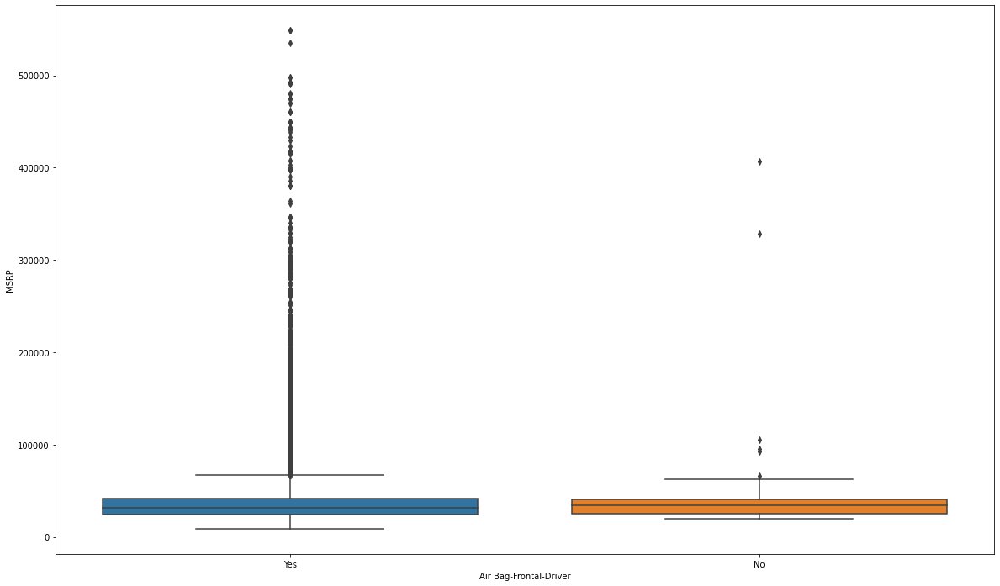

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Air Bag-Frontal-Driver', y='MSRP')

Cars with no frontal driver air bags are on average more expensive than cars with frontal driver air bags. However, the cars with frontal airbags have a much larger range of MSRP values than those without frontal airbags. But, this feature has almost no variance, as 30,229 of the 30,293 instances are "Yes," making this feature basically constant and have no impact of the model.

### Air Bag-Frontal-Passenger

In [ ]:
df_cleaning['Air Bag-Frontal-Passenger'].describe()

count     30293
unique        2
top         Yes
freq      30077
Name: Air Bag-Frontal-Passenger, dtype: object

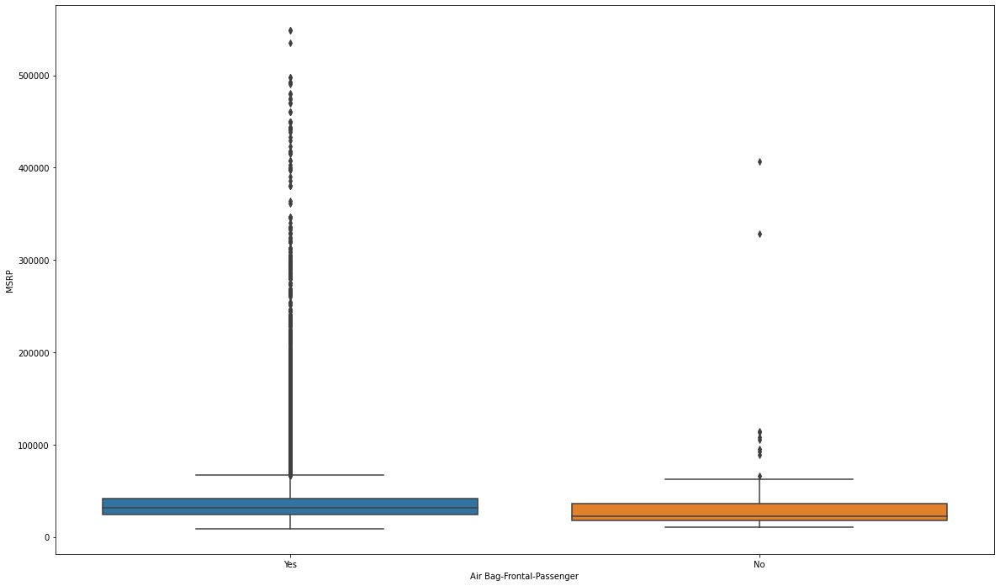

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Air Bag-Frontal-Passenger', y='MSRP')

Having an air bag for the passenger in the front raises the average MSRP of the car. If you were on a budget, the better option would be to buy a car without a passenger airbag. The problem with this feature is that there is almost no variance with the values of the feature meaning this feature is considered "nearly-constant" and have no substantial impact on the model.

### Air Bag-Passenger Switch (On/Off)

In [ ]:
df_cleaning['Air Bag-Passenger Switch (On/Off)'].describe()

count     30293
unique        2
top          No
freq      26877
Name: Air Bag-Passenger Switch (On/Off), dtype: object

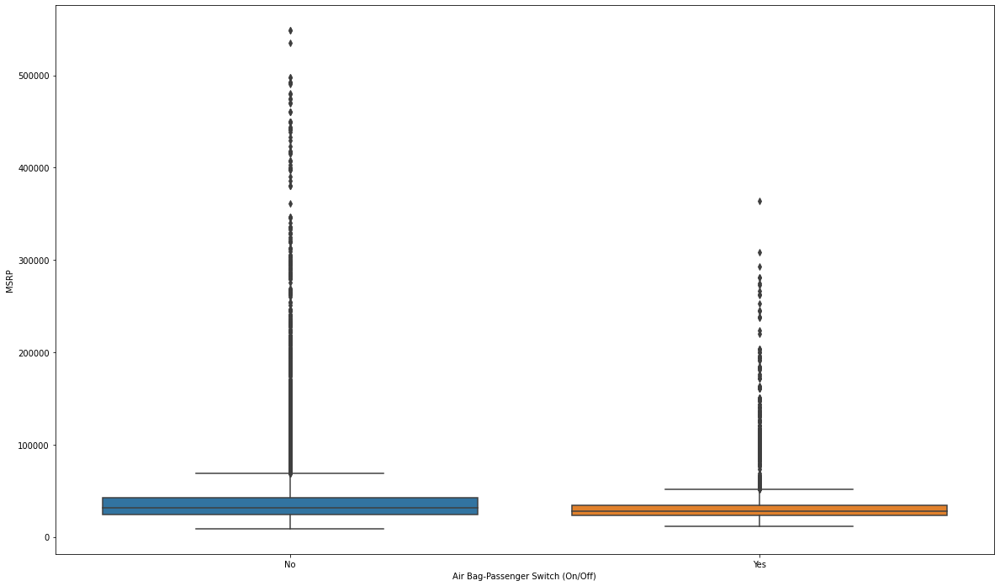

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Air Bag-Passenger Switch (On/Off)', y='MSRP')

Not having a air bag switch, on average has a higher MSRP than an average MSRP priced car with a air bag switch. However, there is a much bigger range in prices for cars without an air bag switch. Since this is the case, using this feature may not be helpful in our regression since their is no clear cut distinction between prices between a car with a switch and without one.

### Air Bag-Side Body-Front

In [ ]:
df_cleaning['Air Bag-Side Body-Front'].describe()

count     30293
unique        2
top         Yes
freq      22384
Name: Air Bag-Side Body-Front, dtype: object

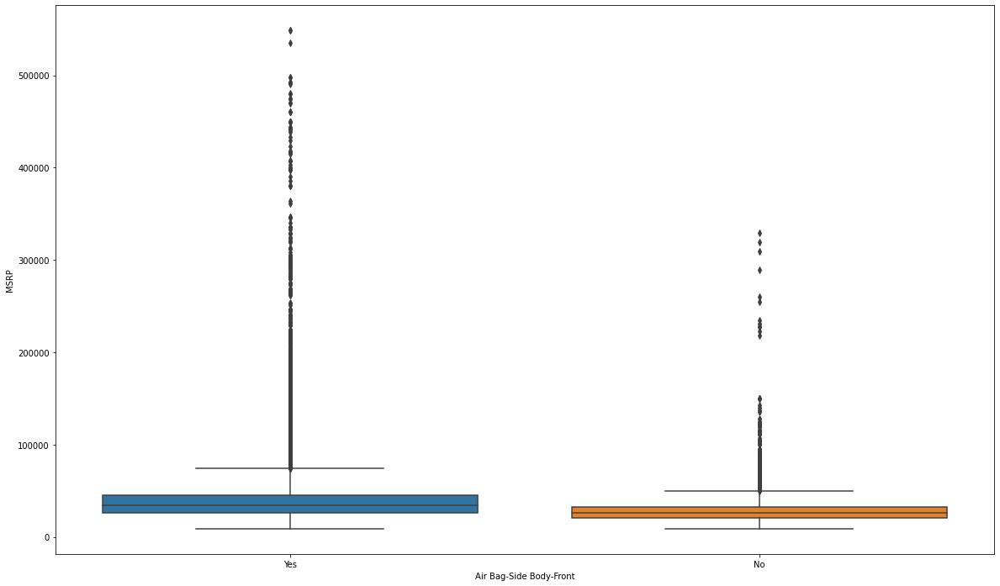

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Air Bag-Side Body-Front', y='MSRP')

Again, this feature has the same problem as the Air Bag switch earlier. There is no clear distinction between MSRP for cars with a side body-front airbag and one without. However, if we look at the top of the box plots, we can see that the "No" value does not reach past 350,000 dollars, so if it the car has a value of "Yes" for this feature, we can assume that it may be over 350,000 dollars. This might prove useful in our regression for top priced cars.

### Air Bag-Side Body-Rear

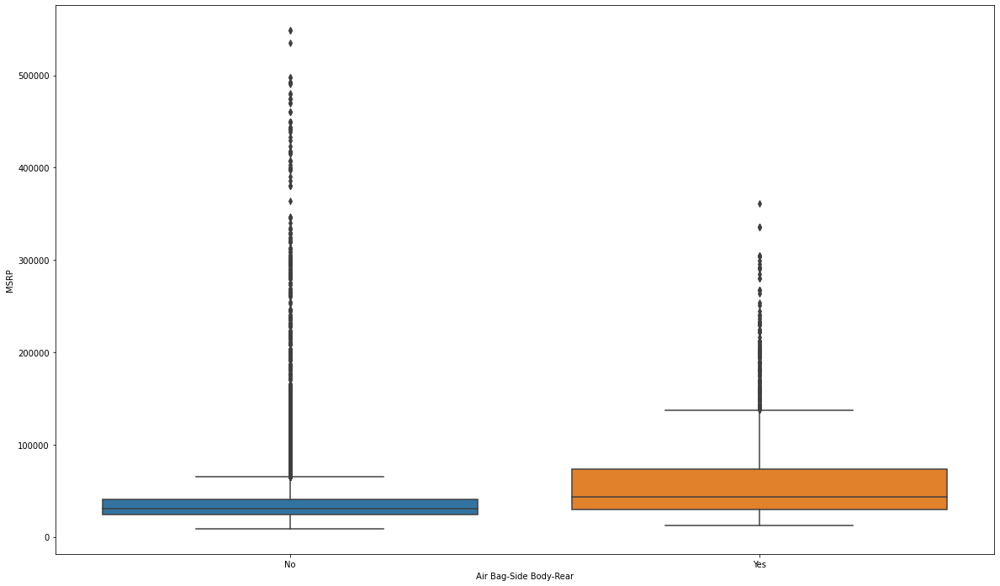

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Air Bag-Side Body-Rear', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Air Bag-Side Body-Rear")['MSRP']

In [ ]:
test.describe()

,count,mean,std,min,25%,50%,75%,max
Air Bag-Side Body-Rear,,,,,,,,
No,28524.0,37323.730963,31116.912461,8599.0,23829.0,30874.5,40353.75,548800.0
Yes,1769.0,60454.406444,49496.977049,12170.0,29835.0,43420.0,72995.00,361500.0


Like the other air bag features, there is a lot of overlap between the two values (Yes and No). But by looking at the data, by a "Yes" value, the MSRP is in a tighter range, as if compared to the "Yes" value. If the instance has a "Yes," the regression model should be able to better predict the price since there are less instances, and a smaller range of MSRP values that it could fall into. I think this feature may be helpful in predicting the prices of instances with the value of "yes." However, with the low variance of this feature's values, the feature will basically be constant, and not provide useful information to our model.

### Air Bag-Side Head-Front

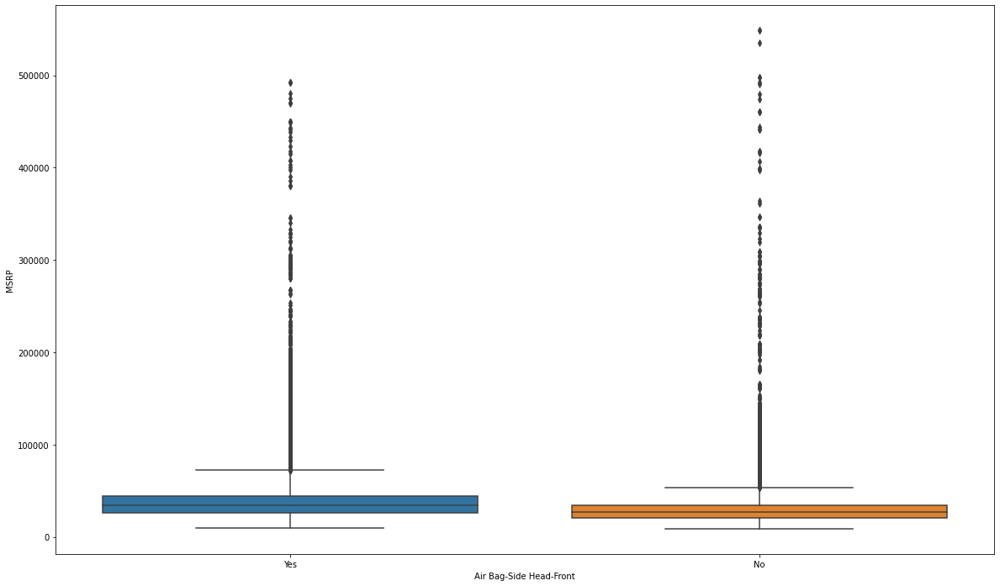

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Air Bag-Side Head-Front', y='MSRP')

In [ ]:
df_cleaning['Air Bag-Side Body-Rear'].describe()

count     30293
unique        2
top          No
freq      28524
Name: Air Bag-Side Body-Rear, dtype: object

Although, there is large range of values for both, "yes" and "no", with the "yes" column with the higher average MSRP, but the "No" has the highest maximum value. This feature might prove useful to our model.

### Air Bag-Side Head-Rear

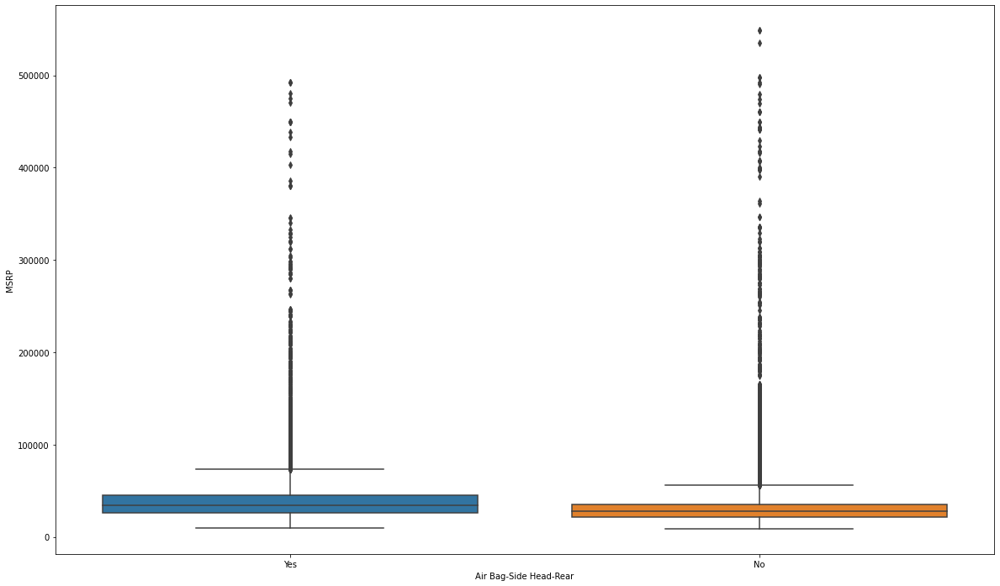

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Air Bag-Side Head-Rear', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Air Bag-Side Head-Rear")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Air Bag-Side Head-Rear,,,,,,,,
No,12551.0,36024.680025,37228.867934,8599.0,21677.5,28045.0,35372.5,548800.0
Yes,17742.0,40548.990418,29362.797509,9970.0,25995.0,34430.0,44792.5,492425.0


There is a good divide of observations with "No" and "Yes". Having a "Yes" value should raise the price for the MSRP of the car as if we compared the car to a similiar one, but without a airbag in the side for the head in the back seat. I think this feature will be slightly helpful in our regression.

### Brakes-ABS

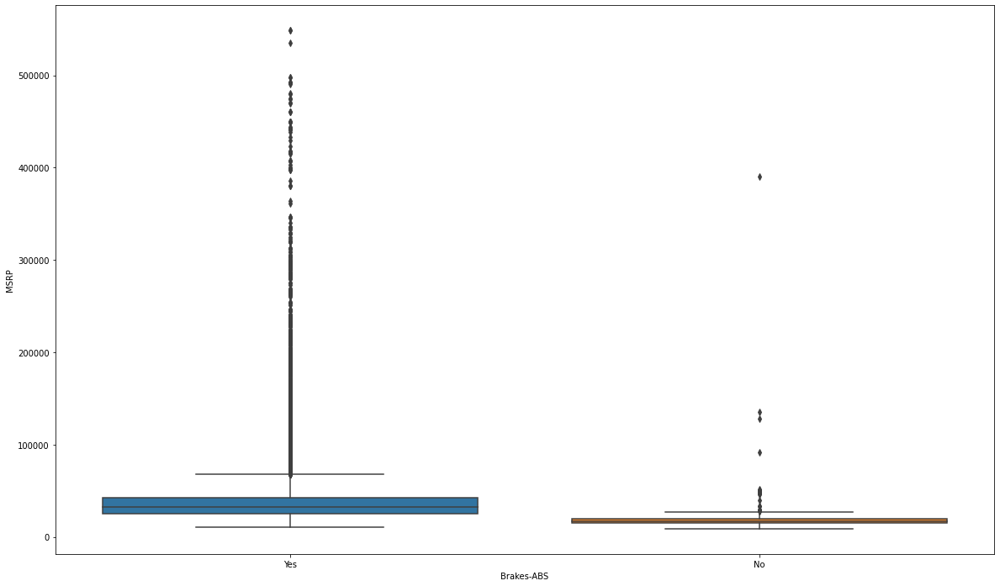

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Brakes-ABS', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Brakes-ABS")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Brakes-ABS,,,,,,,,
No,1702.0,18252.085194,11447.326484,8599.0,14749.0,17098.5,19871.25,389995.0
Yes,28591.0,39890.206638,33385.111632,10575.0,25170.0,32140.0,42150.00,548800.0


From the data, we should tell that having an anti-lock braking system raises the MSRP of the car significantly, on aveage. Cars without an ABS brake system as cheaper almost always, and the most expensive cars all have an ABS system.

### Child Safety Rear Door Locks

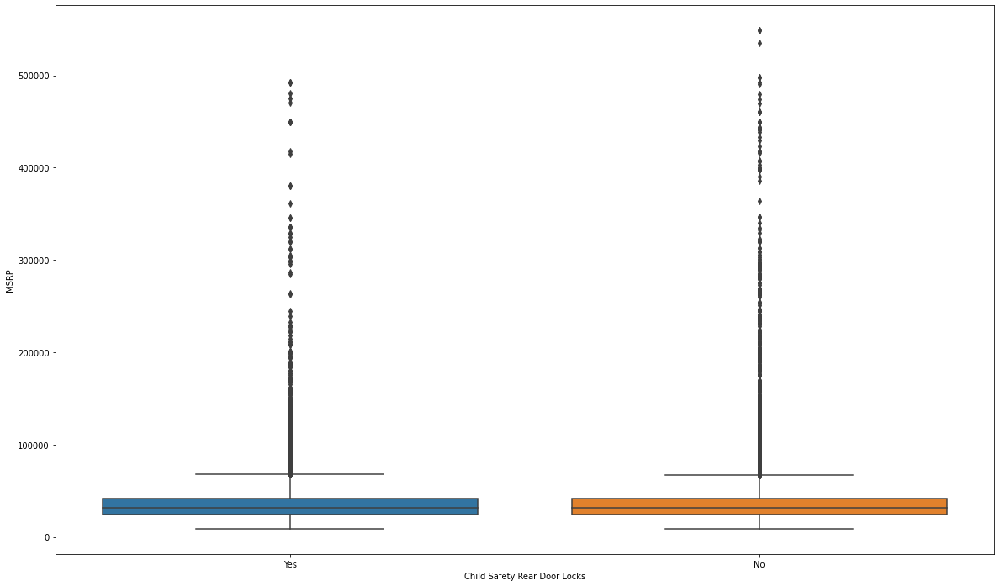

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Child Safety Rear Door Locks', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Child Safety Rear Door Locks")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Child Safety Rear Door Locks,,,,,,,,
No,12110.0,41137.996780,40768.464412,8599.0,24166.25,31200.0,41145.0,548800.0
Yes,18183.0,37033.757136,26316.435734,8999.0,23995.00,31370.0,41462.5,492425.0


From the graph and the sorted described data, it looks very similar to one another. Both the "Yes" and the "No" has almost identical means, standard deviations, minimum and maximum values and also at the 25%, 50% and 75% quartiles. Based on this, I don't think this data will be particurly useful in predicting prices, but I will still test this feature.

### Daytime Running Lights

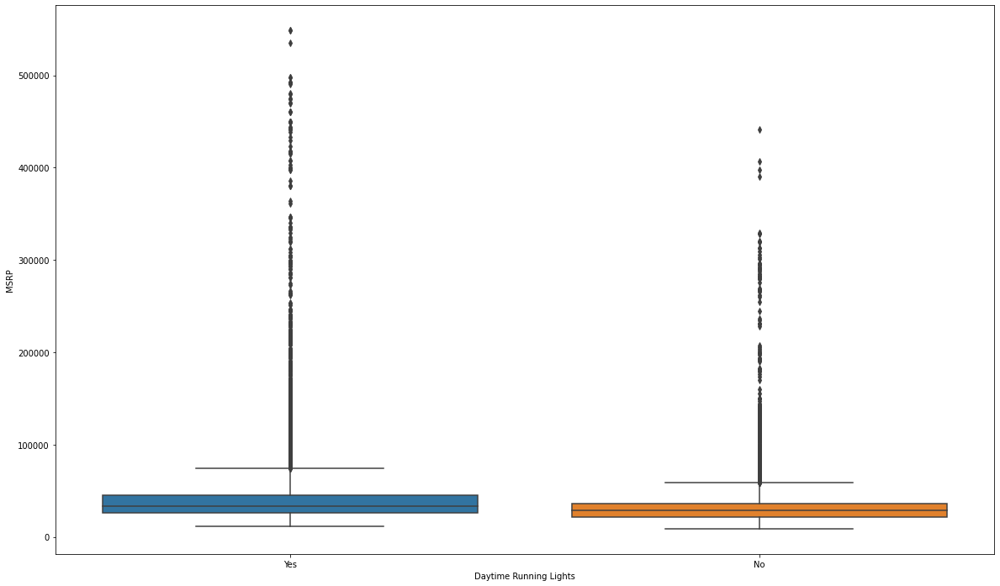

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Daytime Running Lights', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Daytime Running Lights")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Daytime Running Lights,,,,,,,,
No,12390.0,33058.663035,24925.588395,8599.0,21675.0,28347.0,36470.0,441600.0
Yes,17903.0,42560.973692,36980.628213,11150.0,25932.5,33670.0,45385.0,548800.0


From the data, we can tell that cars with daytime running lights are, on average, more expensive than those cars without daytime lights. From this when a car has a value of "Yes," we can assume that the car will be more expensive. This should be useful in our regression.

### Traction Control

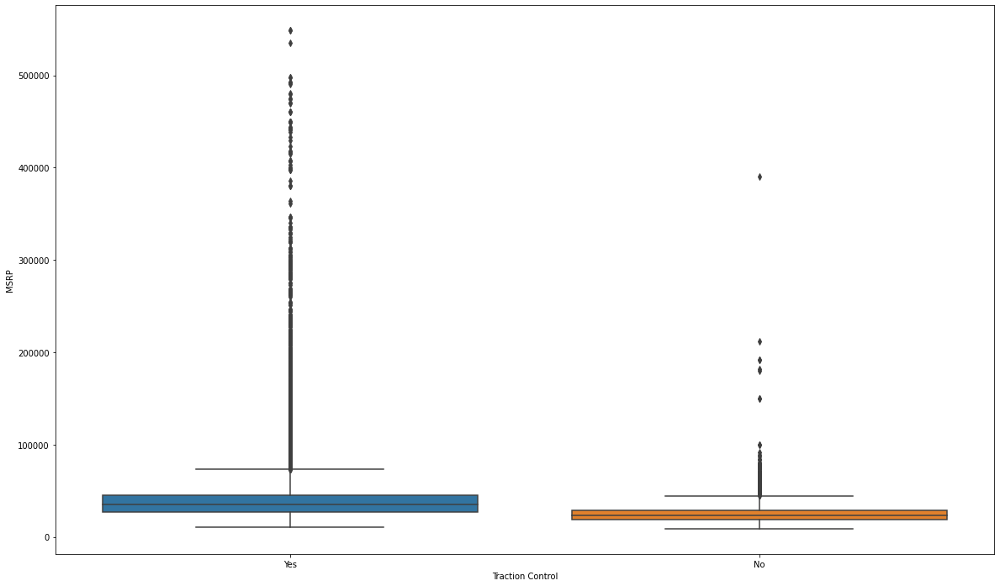

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Traction Control', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Traction Control")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Traction Control,,,,,,,,
No,7542.0,24654.877088,10600.461212,8599.0,18585.75,23427.0,28999.75,389995.0
Yes,22751.0,43322.001846,36325.323213,10990.0,26995.00,34755.0,45605.00,548800.0


From the graph and the table, we can see that those cars with traction control are more expensive. In our models, when a instance has a "Yes" value, we can assume that that the car is going to be slightly more expensive than a similiar car without traction control. I think this will be useful in our regression.

### Night Vision

If you would like to see some cars with night vision capability, I have included a link to see this feature in action.

[Night Vision](https://www.youtube.com/watch?v=hp9lR4x7Kok)

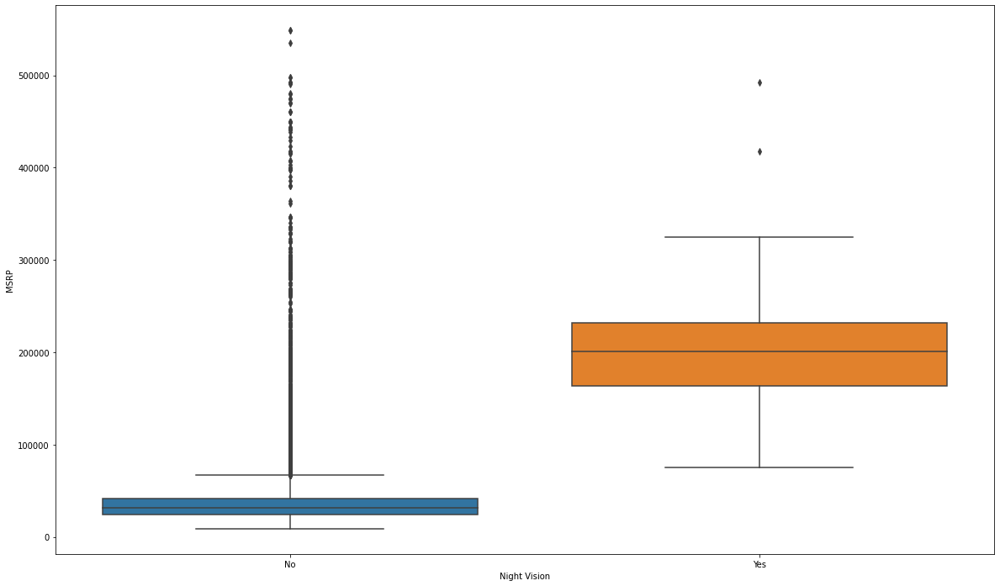

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Night Vision', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Night Vision")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Night Vision,,,,,,,,
No,30250.0,38434.609818,32194.301071,8599.0,24050.0,31265.0,41300.0,548800.0
Yes,43.0,207418.604651,78986.386058,75095.0,163600.0,201150.0,231725.0,492425.0


Having a night vision feature in your car dramatically raises the average prices of the car. With night vision, the average is $82,415 and without is 34,256. However, due to the lack of "Yes" values, the variance of the feature is low and won't help the model since this feature is near constant.

### Rollover Protection Bars

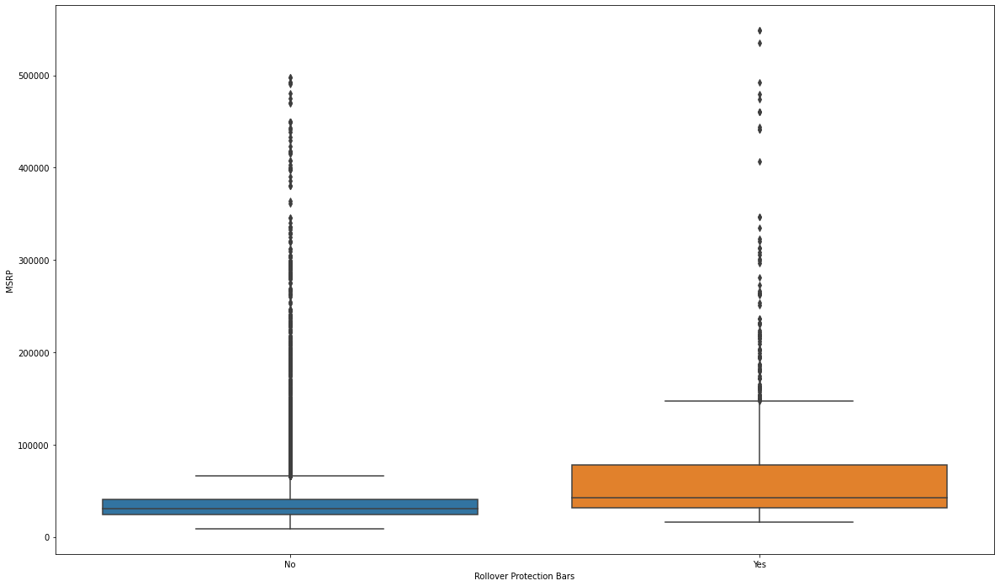

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Rollover Protection Bars', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Rollover Protection Bars")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Rollover Protection Bars,,,,,,,,
No,29119.0,37512.448710,30128.226255,8599.0,23875.0,30960.0,40607.5,497650.0
Yes,1174.0,67496.552811,67819.375631,16215.0,31795.0,42850.0,77837.5,548800.0


There is a large of MSRP prices for both the "Yes" and "No" value. Although the cars with Rollover Protection Bars are much more expensive. But, due to the high number of "No" values, the variance of this feature is low, possibly making this feature near-constant with no relevant information to give to our model.

### Fog Lamps

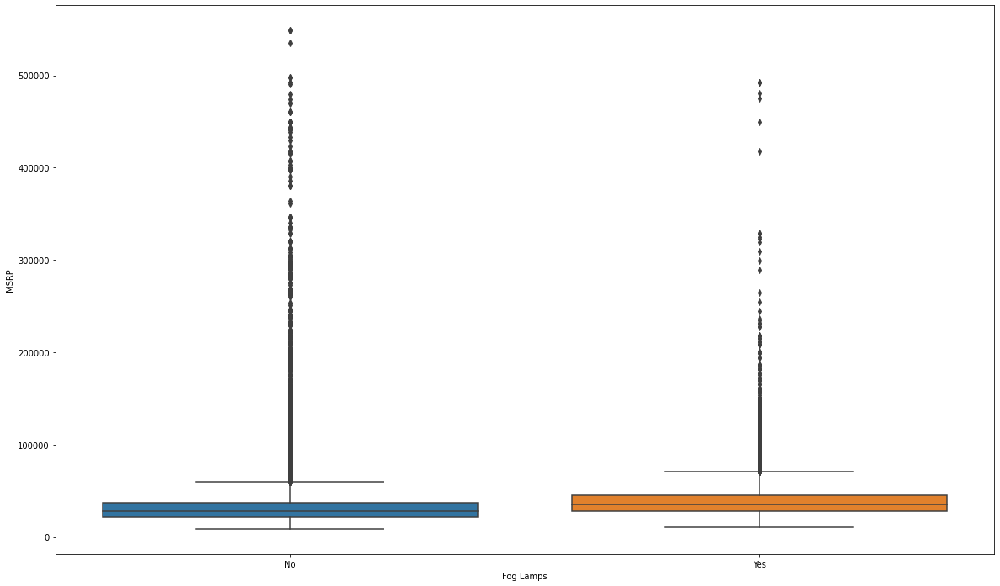

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Fog Lamps', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Fog Lamps")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Fog Lamps,,,,,,,,
No,15073.0,37243.344590,40066.985336,8599.0,21310.0,27500.0,36640.00,548800.0
Yes,15220.0,40091.788042,23747.929606,10199.0,27655.0,34950.0,44776.25,492425.0


From the table and graph, we can see that, on average, cars with Fog Lamps are more expensive than those cars without Fog Lamps. But, those cars without Fog Lamps have more higher priced cars than those with Fog Lamps. I think this feature will be useful in predicitng high-priced cars.

### Parking Aid

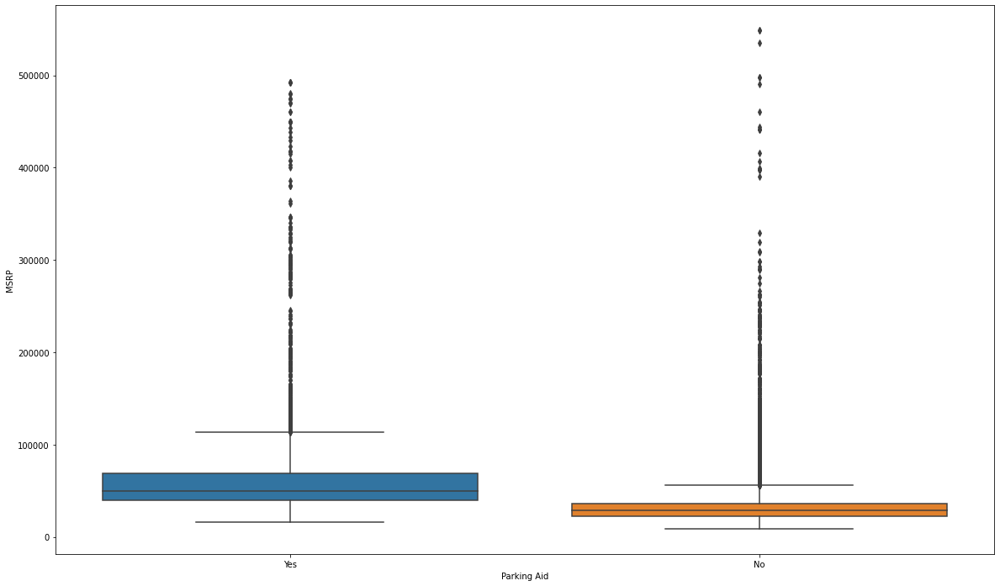

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Parking Aid', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Parking Aid")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Parking Aid,,,,,,,,
No,24438.0,32538.764506,22684.973904,8599.0,22710.0,28627.0,36075.0,548800.0
Yes,5855.0,64284.136635,51464.591997,16190.0,39300.0,49300.0,69097.5,492425.0


Cars with a parking aid are much more expensive than cars without parking aids, on average, although, the most expensive car does not have one. This makes sense as more affordable cars do not have these parking sensors to help the driver park, while the cars with these are usually more expensive. This feature, along with others, should be useful in our regression.

### Tire Pressure Monitor

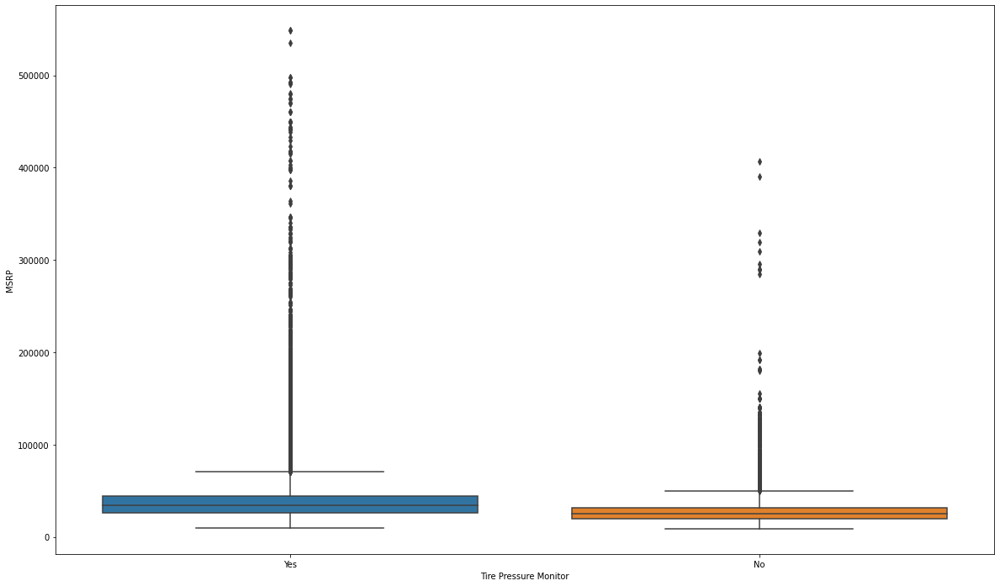

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Tire Pressure Monitor', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Tire Pressure Monitor")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Tire Pressure Monitor,,,,,,,,
No,8111.0,29426.517076,19724.901461,8599.0,19732.5,24999.0,31850.0,407000.0
Yes,22182.0,42056.057479,35994.463866,9970.0,26332.5,33995.0,44150.0,548800.0


Cars without a tire pressure monitor are, on average less expensive than those with a tire pressure monitor. Additionally, those without one, are generally less expensive than those with one. I think this may be useful in our regression.

### Back-Up Camera

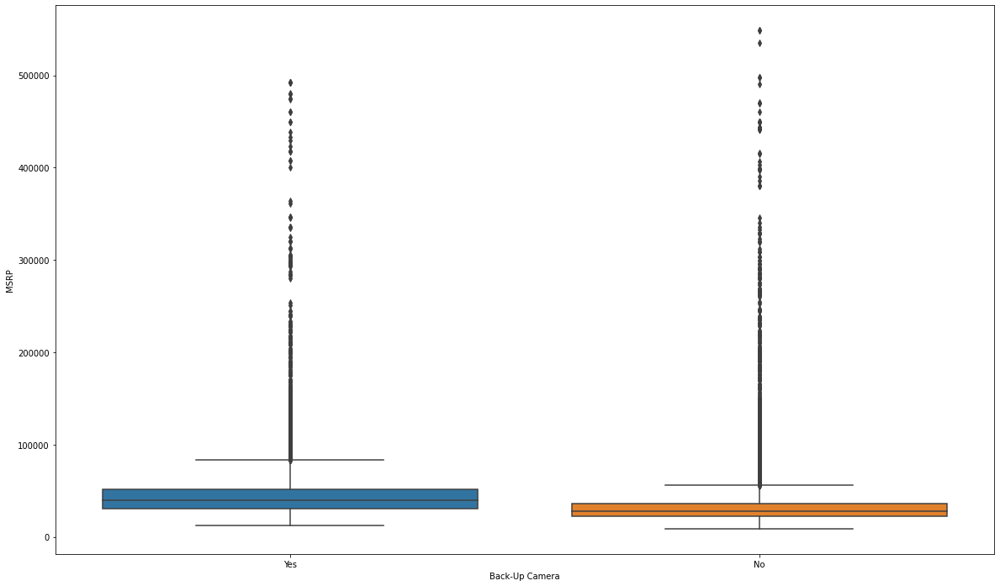

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Back-Up Camera', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Back-Up Camera")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Back-Up Camera,,,,,,,,
No,20078.0,33996.014344,30200.000766,8599.0,22050.0,28165.0,35688.0,548800.0
Yes,10215.0,47870.188057,35984.794812,12310.0,30700.0,39655.0,51855.0,492425.0


Although it seems that back-up cameras are becoming more common on affordable cars, we must remember that this dataset contains cars from 1996, where these modern inventions were not present. Even as back-up cameras became more common, they were expensive to have, back in in the early days of them, leading to increased MSRP for these cars. Nonetheless, this feature should be able to raise the price of the if the value is "Yes."

### Stability Control

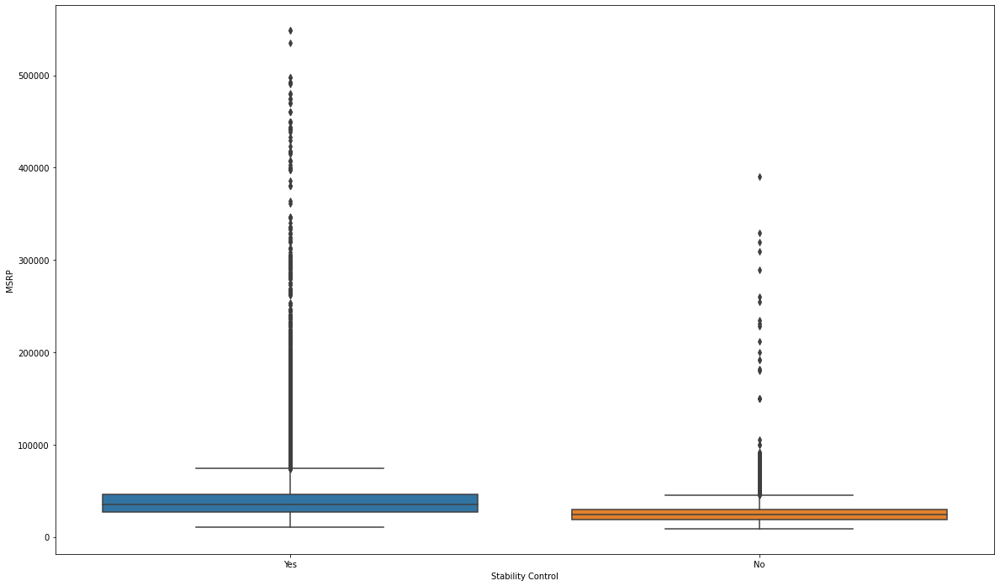

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Stability Control', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Stability Control")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Stability Control,,,,,,,,
No,8633.0,25935.308352,14268.476466,8599.0,19165.0,24010.0,29710.00,389995.0
Yes,21660.0,43751.912742,36669.389130,10990.0,27295.0,35100.0,46046.25,548800.0


Cars without stability control are usually much less expensive, that being on average, at the minimum and at the maximum. I think we can use this to determine those cars without stability control will be less expensive than a comparable car with stability control. This may prove useful in our regression.

### Basic Miles/km

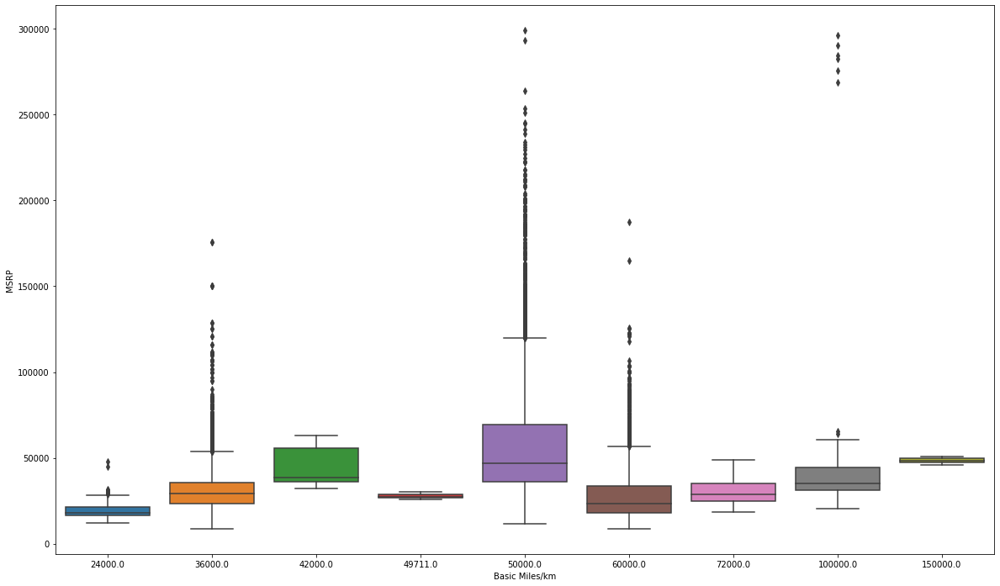

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Basic Miles/km', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Basic Miles/km")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Basic Miles/km,,,,,,,,
24000.0,255.0,19366.086275,4697.484064,11990.0,16320.00,17995.0,21200.00,47650.0
36000.0,19830.0,30506.021785,10721.775614,8599.0,23455.00,29025.0,35623.75,175540.0
42000.0,5.0,45000.000000,13476.831972,32000.0,36000.00,38500.0,55500.00,63000.0
49711.0,6.0,27795.000000,1528.397854,25995.0,26845.00,27395.0,28845.00,29995.0
50000.0,7140.0,56736.611625,32770.751065,11590.0,35925.00,46662.5,69538.75,299000.0
60000.0,2276.0,29332.231986,18055.660305,8749.0,18200.00,23500.0,33568.75,187500.0
72000.0,137.0,30118.649635,6706.546366,18645.0,24695.00,28895.0,35070.00,48740.0
100000.0,214.0,44288.574766,41620.091658,20490.0,31175.00,35310.0,44252.50,295987.0
150000.0,16.0,48347.500000,1515.276652,45860.0,47226.25,48500.0,49637.50,50595.0


From the data output, there doesn't seem to be a large difference between MSRP and the number of basic miles you get. Those cars with more miles are not more expensive than cars with lower miles. I do not think this feature will be important in our regression.

### Basic Years

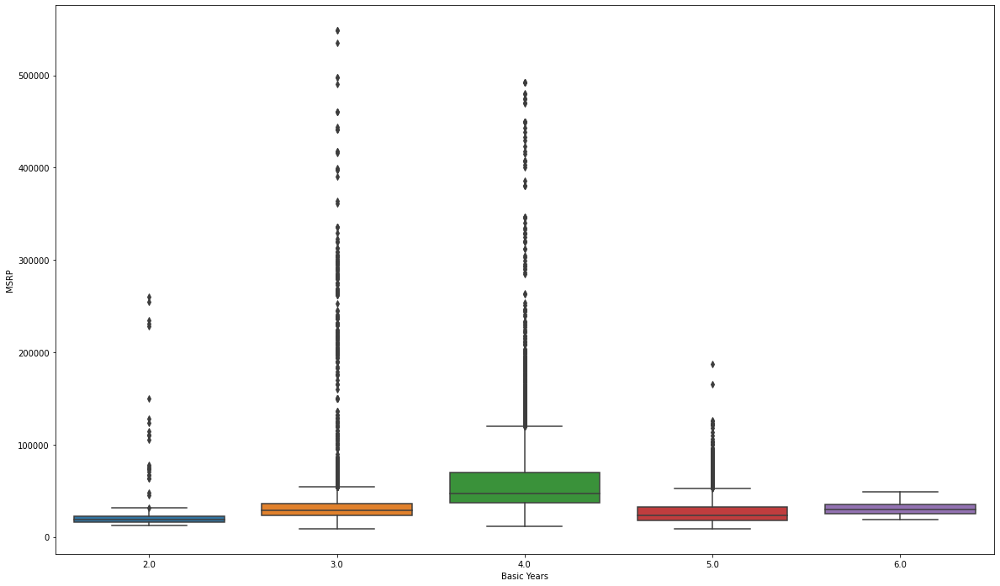

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Basic Years', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Basic Years")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Basic Years,,,,,,,,
2.0,277.0,27781.884477,34749.015805,11990.0,16350.0,18775.0,22320.00,260000.0
3.0,20146.0,32559.027301,25576.625552,8599.0,23500.0,29140.0,35895.00,548800.0
4.0,7280.0,59663.967308,44371.211586,11590.0,36582.5,47120.0,69923.75,492425.0
5.0,2301.0,28718.583225,17594.376775,8749.0,18290.0,23545.0,32100.00,187500.0
6.0,141.0,30647.659574,7304.053194,18645.0,24995.0,29545.0,35550.00,49250.0


Again, the more number of basic years a number has, does not mean the car is more expensive. Actually, cars with only 2 years of basic years have the largest range of MSRP values, while 4 years of basic years have the highest average MSRP. This might be useful in determining prices ranges of certain number of years, but I'm not sure of its significance in the model.

### Corrosion Miles/km

There is an unlimited value in this feature, to make it inline with the rest of the values, I am converting this number to 200,000.

In [ ]:
df_cleaning['Corrosion Miles/km'] = df_cleaning['Corrosion Miles/km'].str.replace(",","")
df_cleaning['Corrosion Miles/km'] = df_cleaning['Corrosion Miles/km'].str.replace("Unlimited","200000")

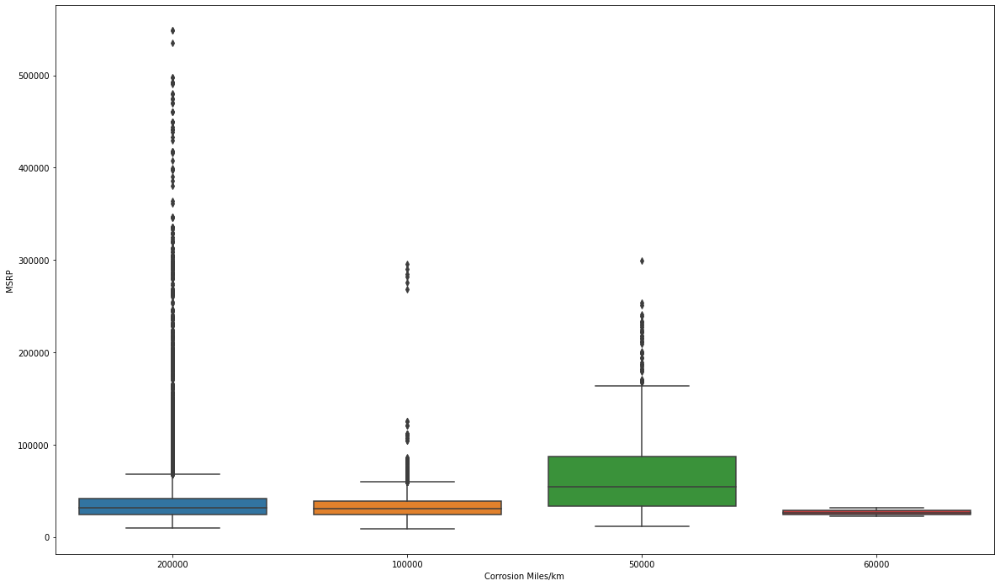

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Corrosion Miles/km', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Corrosion Miles/km")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Corrosion Miles/km,,,,,,,,
100000,7400.0,32569.362027,13925.234683,8599.0,24298.75,30970.0,38391.25,295987.0
200000,20747.0,39244.115920,34907.286876,9970.0,24095.00,31200.0,41717.50,548800.0
50000,1105.0,66142.246154,45239.159219,11590.0,33400.00,53850.0,86750.00,299000.0
60000,6.0,26580.000000,3620.270708,22150.0,24075.00,26100.0,29205.00,31490.0


It seems as if the number of miles largens the range of the MSRP values that the car could fall into. From the data, although the average MSRP for 100k and 200k miles, the maximum price is about the same, if not more. Albeit, as the number of miles gets larger, the price for the average car decreases. This may be useful in our regression.

### Corrison Years

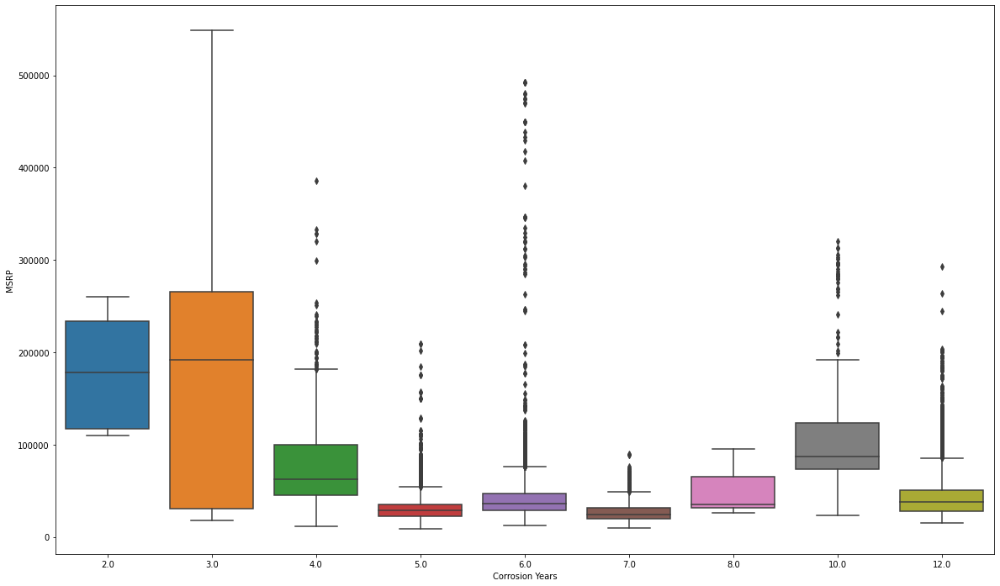

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Corrosion Years', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Corrosion Years")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Corrosion Years,,,,,,,,
2.0,10.0,179532.000000,66479.190529,110000.0,116900.00,177900.0,233510.00,260000.0
3.0,218.0,170571.958716,141113.081774,17475.0,30846.25,191990.0,265818.75,548800.0
4.0,965.0,78606.066321,49589.463723,11590.0,45400.00,62750.0,99950.00,385500.0
5.0,15486.0,29983.440269,11429.534796,8599.0,22555.00,28422.5,35403.75,208800.0
6.0,6722.0,42640.483785,33611.223606,12170.0,28410.00,35722.5,47332.50,492425.0
7.0,1319.0,27758.003033,12120.386589,9970.0,19959.50,24550.0,31582.50,90100.0
8.0,64.0,44143.046875,19643.626448,26370.0,31385.00,34790.0,65650.00,94900.0
10.0,267.0,111919.816479,70525.532747,22990.0,73700.00,87000.0,123325.00,320695.0
12.0,4245.0,45864.828740,29099.879504,14900.0,27675.00,37850.0,50950.00,293200.0


There doesn't seem to be any correlation between more corrision years and MSRP. A car may have 12 years of corrosion, but it doesn't mean the MSRP is the highest. Actually, the cars with the least number of years (2 and 3) are the most expensive, on average, but for those there aren't observations that have 2 or 3 corrosion years. The most useful year may be 5 and 6 since they have the most observations.

### Drivetrain Miles/km

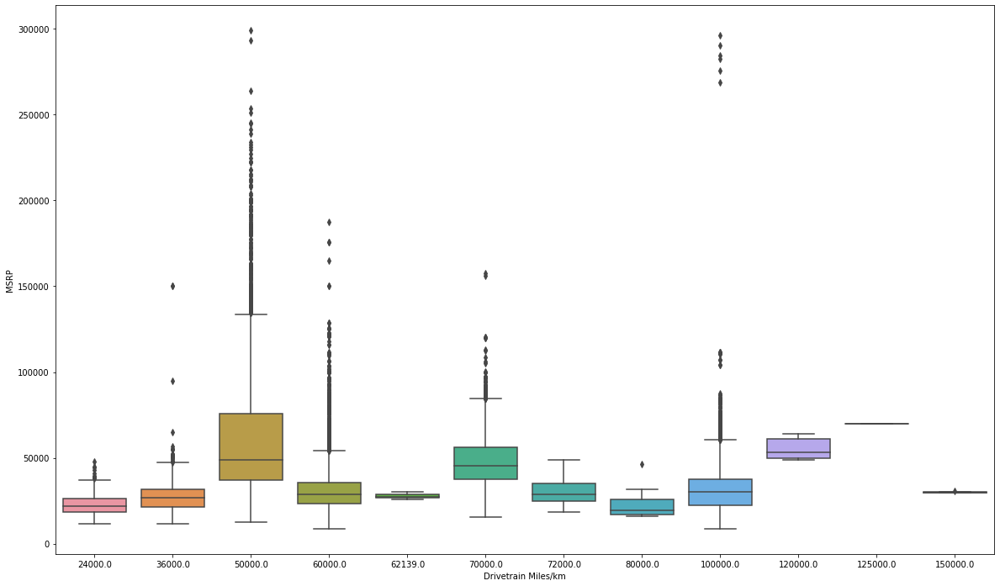

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Drivetrain Miles/km', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Drivetrain Miles/km")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Drivetrain Miles/km,,,,,,,,
24000.0,227.0,22946.198238,6515.391796,11485.0,18467.50,22070.0,26137.50,47650.0
36000.0,2928.0,27296.386270,7989.144971,11580.0,21600.00,26800.0,31879.75,149995.0
50000.0,4916.0,60591.589504,35624.965569,12490.0,37250.00,48742.5,75800.00,299000.0
60000.0,12739.0,30730.577832,12249.567823,8599.0,23192.50,28550.0,35627.50,187500.0
62139.0,6.0,27795.000000,1528.397854,25995.0,26845.00,27395.0,28845.00,29995.0
70000.0,1584.0,49102.404040,17065.160114,15305.0,37385.00,45605.0,56175.00,157500.0
72000.0,137.0,30118.649635,6706.546366,18645.0,24695.00,28895.0,35070.00,48740.0
80000.0,10.0,23627.600000,9431.232525,16012.0,17193.25,19449.5,25880.00,46225.0
100000.0,6519.0,31438.402056,14421.860647,8749.0,22395.00,29995.0,37645.00,295987.0


### Drivetrain Years

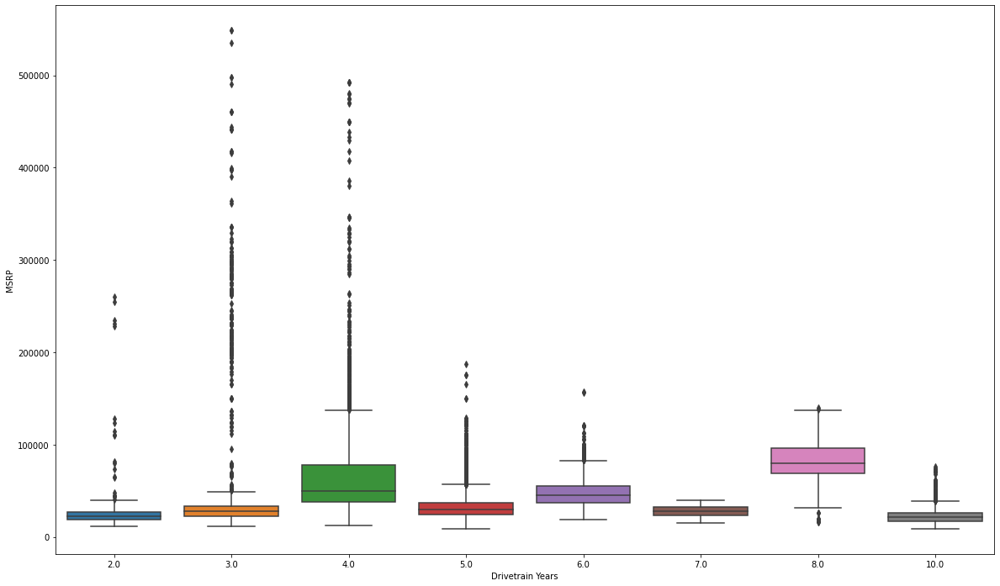

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Drivetrain Years', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Drivetrain Years")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Drivetrain Years,,,,,,,,
2.0,242.0,30448.789256,34907.938037,11485.0,18761.25,22487.5,27191.25,260000.0
3.0,3160.0,40570.797785,58615.876876,11580.0,21965.00,27425.0,33225.00,548800.0
4.0,4920.0,63921.097358,47492.047685,12490.0,37450.00,49400.0,77600.00,492425.0
5.0,17140.0,31937.424971,12252.802642,8599.0,24070.00,29995.0,37155.00,187500.0
6.0,1636.0,48568.047066,17102.306314,18645.0,37080.00,45100.0,55405.00,157500.0
7.0,105.0,27778.171429,5990.208696,14890.0,23405.00,28165.0,32300.00,39780.0
8.0,71.0,79923.605634,32143.020521,16012.0,68950.00,80000.0,96500.00,140000.0
10.0,2100.0,22403.447619,8244.481582,8749.0,17070.00,21142.5,25795.00,76350.0


### Turning Diameter - Curb to Curb (ft)

In [ ]:
test = df_cleaning.groupby(by="Turning Diameter - Curb to Curb (ft)")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Turning Diameter - Curb to Curb (ft),,,,,,,,
15.40,35.0,24443.285714,2151.961124,20435.0,22935.00,24465.0,26350.0,28210.0
15.90,5.0,9759.000000,522.494019,8999.0,9599.00,9699.0,10199.0,10299.0
17.10,13.0,19532.692308,2415.219638,15345.0,17925.00,19685.0,21645.0,22945.0
17.25,4.0,16249.000000,1190.238071,14999.0,15374.00,16249.0,17124.0,17499.0
17.30,8.0,16324.000000,1129.791384,14999.0,15374.00,16399.0,17124.0,17799.0
...,...,...,...,...,...,...,...,...
59.60,4.0,45696.250000,7995.802414,36945.0,40736.25,45225.0,50185.0,55390.0
61.60,21.0,31577.857143,3486.029823,26150.0,28515.00,31805.0,34200.0,36600.0
72.60,3.0,29155.000000,637.945922,28630.0,28800.00,28970.0,29417.5,29865.0


### Front Wheel Material

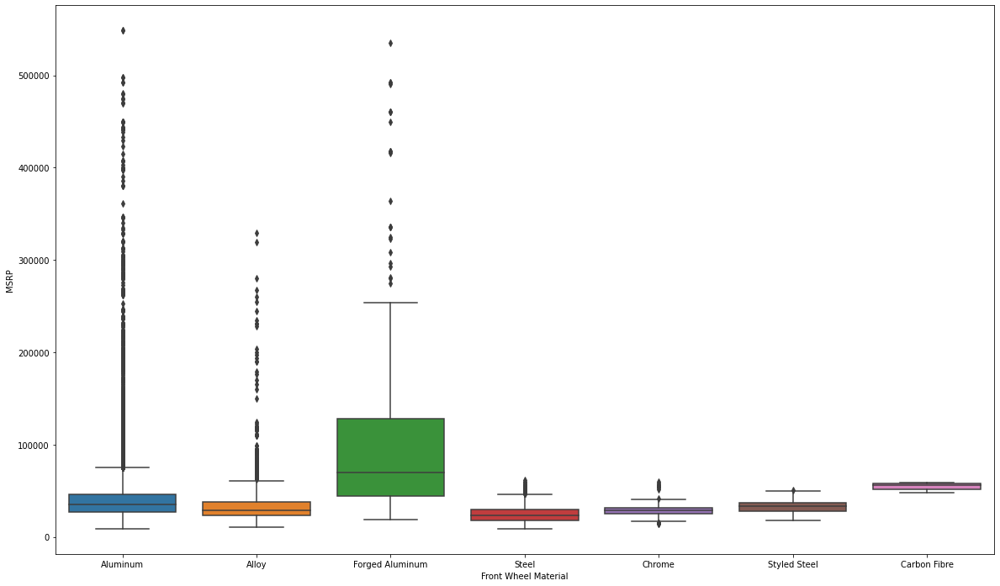

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Front Wheel Material', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Front Wheel Material")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Front Wheel Material,,,,,,,,
Alloy,2685.0,34351.801117,23093.441379,10799.0,22995.0,28900.0,38300.0,328990.0
Aluminum,19527.0,43265.918933,35074.484683,8749.0,26905.0,34935.0,46147.5,548800.0
Carbon Fibre,3.0,54291.666667,5849.359652,47795.0,51867.5,55940.0,57540.0,59140.0
Chrome,285.0,28774.642105,6709.191552,14395.0,25261.0,28506.0,31497.0,59360.0
Forged Aluminum,395.0,105340.564557,90037.649610,18700.0,44567.5,69600.0,128515.0,535500.0
Steel,6869.0,24238.465716,7627.440183,8599.0,18200.0,23300.0,29600.0,61490.0
Styled Steel,515.0,32761.038835,6470.448661,17990.0,28167.5,32990.0,37007.5,50500.0


Most cars use aluminum as their wheel material, while less expensive cars could use almost any type of wheel material, and on average, their price will be about the same. High end cars use forged aluminum, aluminum and alloy as their wheel material, as these cars are the only ones to reach over 100k MSRP. Some of these columns may be dropped due to low variance during dummy encoding.

### Front Tire Size

In [ ]:
test = df_cleaning.groupby(by="Front Tire Size")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Front Tire Size,,,,,,,,
175/70R14,1.0,13795.000000,NaN,13795.0,13795.0,13795.0,13795.0,13795.0
"18""",2.0,46505.000000,4744.686502,43150.0,44827.5,46505.0,48182.5,49860.0
185/55R15,16.0,21604.062500,4233.007685,15500.0,18500.0,21097.5,23905.0,31800.0
185/60R15,11.0,15620.909091,2517.771652,13225.0,14075.0,14825.0,15502.5,20980.0
"185/60R15C, 95/92T TL",6.0,22918.333333,800.841224,21955.0,22180.0,23185.0,23515.0,23715.0
...,...,...,...,...,...,...,...,...
P305/30ZR19,3.0,54291.666667,5849.359652,47795.0,51867.5,55940.0,57540.0,59140.0
P305/35YR20,4.0,55320.000000,11166.430346,38995.0,53995.0,58995.0,60320.0,64295.0
P315/40WR18,1.0,83295.000000,NaN,83295.0,83295.0,83295.0,83295.0,83295.0


Due to the 801 unique front tire sizes in this features, I am going to drop this column instead of adding 801 additional features to the dataframe from one hot encoding.

In [ ]:
df_cleaning = df_cleaning.drop('Front Tire Size', axis=1)

### Roadside Assistance Years

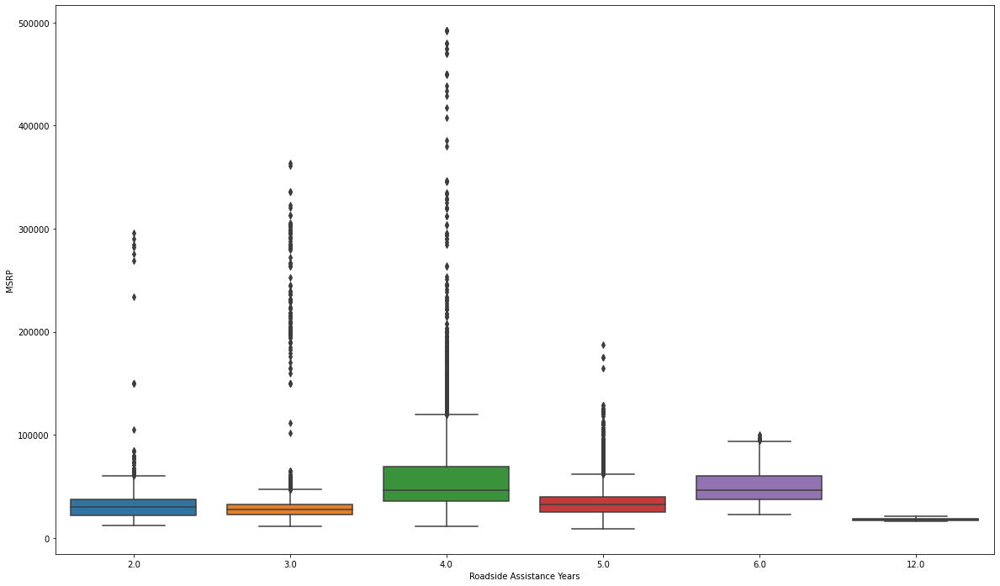

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Roadside Assistance Years', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Roadside Assistance Years")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Roadside Assistance Years,,,,,,,,
2.0,1318.0,32573.740516,22070.567421,12490.0,22156.25,30002.5,37350.00,295987.0
3.0,7473.0,31348.917168,27747.517554,11485.0,22960.00,27330.0,32670.00,363730.0
4.0,5642.0,59244.011343,44680.067435,11590.0,35900.00,46250.0,69546.25,492425.0
5.0,9528.0,34179.159950,14032.634349,8749.0,25195.00,32300.0,39981.25,187500.0
6.0,661.0,49989.470499,17246.859605,22990.0,37340.00,46295.0,59940.00,100295.0
12.0,10.0,18110.000000,1831.332241,15900.0,16850.00,17900.0,19000.00,20900.0


There doesn't seem to be any type of trend that relates the number of roadside assistance years to MSRP. Just because the car has more years doesn't mean the MSRP will increase, actually, past 4 years, the average MSRP decrease.

### Roadside Assistance Miles/km

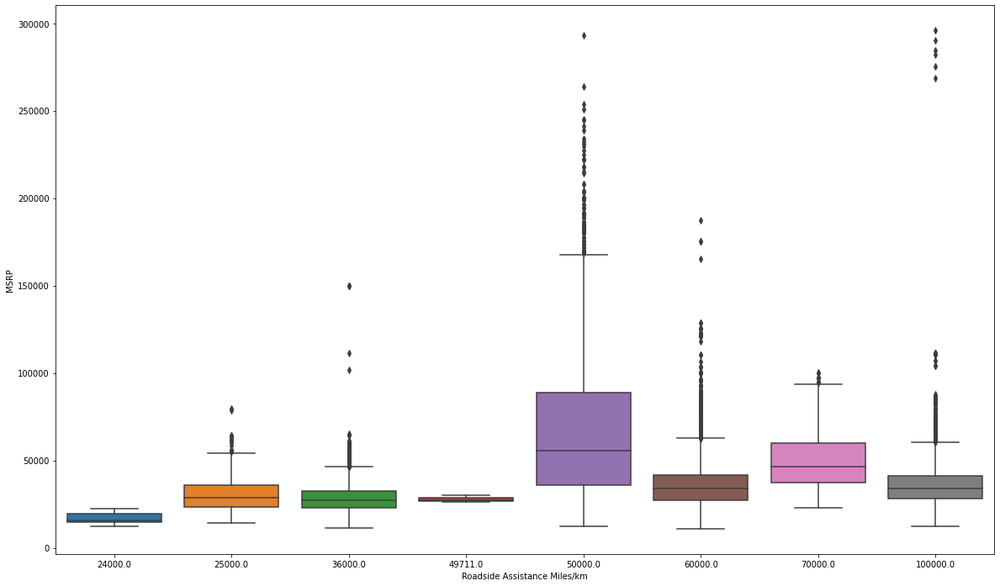

In [ ]:
plt.figure(figsize=(20,12))
sns.boxplot(data=df_cleaning, x='Roadside Assistance Miles/km', y='MSRP')

In [ ]:
test = df_cleaning.groupby(by="Roadside Assistance Miles/km")['MSRP']
test.describe()

,count,mean,std,min,25%,50%,75%,max
Roadside Assistance Miles/km,,,,,,,,
24000.0,35.0,16736.857143,2932.778267,12490.0,14460.0,15530.0,19570.00,22320.0
25000.0,401.0,30782.082294,10552.199840,14115.0,23550.0,28625.0,35935.00,79605.0
36000.0,7258.0,28206.144255,8132.651509,11485.0,22802.5,27105.0,32303.75,149995.0
49711.0,6.0,27795.000000,1528.397854,25995.0,26845.0,27395.0,28845.00,29995.0
50000.0,2484.0,66859.613124,41906.484711,12490.0,35787.5,55800.0,88825.00,293200.0
60000.0,4635.0,36127.446818,14901.022609,10770.0,27240.0,33985.0,41395.00,187500.0
70000.0,661.0,49989.470499,17246.859605,22990.0,37340.0,46295.0,59940.00,100295.0
100000.0,3608.0,36137.009701,15714.692586,12170.0,28207.5,33790.0,41061.25,295987.0


Increasing the number of roadside assistance miles a car comes with, does not equate to an increase in average MSRP. The highest average MSRP is at 50,000 and 70,000 miles. Other than that, the average MSRP varies for each set of miles. This might be useful in our regression, but I think its impact will be minimal.

# Experiments

In this section, I am going to prepare the data for the sklearn models based upon the features. I am creating a copy of the cleaned dataset, so if there are any problems, I can fall back to the starting dataframe. Also, I am going to fill in the missing values using the median value of the each feature. I choose to fill the missing values with the median because my data is skewed, so it is a better idea to fill in the missing data using the median value.

In [ ]:
df_models = df_cleaning.copy()

In [ ]:
df_models = df_models.fillna(df_models.median())

### Checking For Skew

To further reduce the skew of the data, we can apply a log function across the sale prices to reduce, a common way to reduce skew in one's data.

[Handle Skew](https://towardsdatascience.com/top-3-methods-for-handling-skewed-data-1334e0debf45)

In [ ]:
numerical = df_models.select_dtypes(exclude=['object', 'datetime'])

In [ ]:
skew = numerical.skew()

In [ ]:
cols = numerical.columns

In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['Feature', 'Skew']),
                               cells=dict(values=[cols, skew]))])
fig.show()

As of right now, there is some degree of asymmetry in our data. To reduce the skew in the data, I will be applying a log transformation to the data.

In [ ]:
for col in numerical:
  if df_models[col].skew() > 1:
    df_models[col] = np.log1p(df_models[col])

In [ ]:
numerical = df_models.select_dtypes(exclude=['object', 'datetime'])

In [ ]:
skew = numerical.skew()

In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['Feature', 'Skew']),
                               cells=dict(values=[cols, skew]))])
fig.show()

After our log transformation, all but three features are below 1, but overall, the log transformation has made the skew better for all the features.

### Dummy Variables and Label Encoding

In this section, I created dummy variables for our categorical data ("Yes"/"No" and other). I used the label encoder if the feature only have two unique values, and I created dummy variables for the rest of categorical data.

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
le = LabelEncoder()

In [ ]:
col = df_models.columns

In [ ]:
le_eligible = [c for c in col if len(df_models[c].unique()) == 2]

In [ ]:
for c in le_eligible:
 df_models[c] = le.fit_transform(df_models[c])

In [ ]:
df_models = pd.get_dummies(df_models)

In [ ]:
df_models = pd.DataFrame(df_models)

In [ ]:
df_models_rows, df_models_cols = df_models.shape

In [ ]:
print("Before removing any features, there are {} instances and {} columns.".format(df_models_rows, df_models_cols))

Before removing any features, there are 30293 instances and 182 columns


### Correlation Matrix

Below, I am printing out a correlation matrix of all the numerical information from the dataset. I am going to drop any features that have a correlation above 0.90. Highly correlated features often are redundant and do not improve the model. It is better to drop one of the highly correlated features.

In [ ]:
numbers = df_models.select_dtypes(include=['float64','int64'])

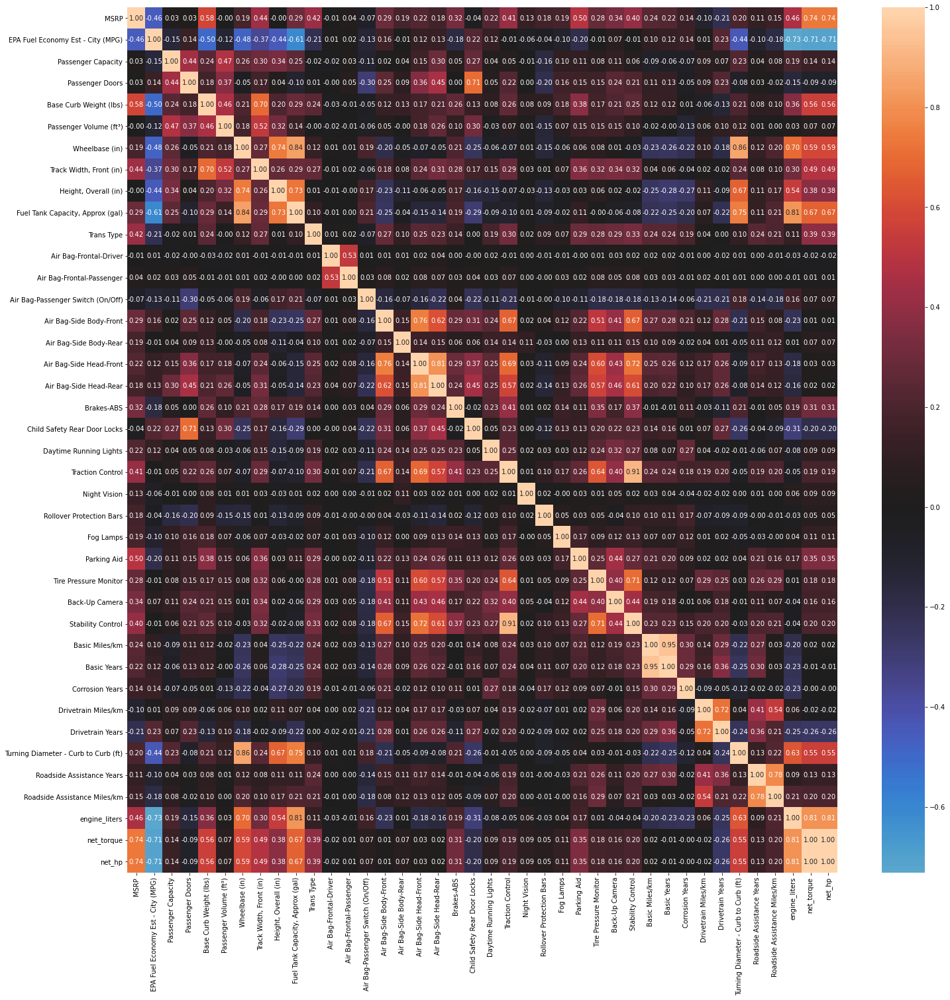

In [ ]:
plt.figure(figsize=(24,24))
sns.heatmap(numbers.corr(), vmax=1.0, center =0, fmt='.2f',
            annot=True)

In [ ]:
cor = numbers.corr()

In [ ]:
upper_tri = cor.where(np.triu(np.ones(cor.shape),k=1).astype(np.bool))


In [ ]:
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.9)]

In [ ]:
df_models = df_models.drop(to_drop, axis=1)

### Extracting Values

In this section, I extracted the X_values and the y_values from the model dataframe. I extracted the y_values by slicing the 'MSRP' values from the dataframe, and then I extracted the X_values by dropping the 'MSRP' feature from the dataframe and keeping the rest of the features.

In [ ]:
y_df = df_models['MSRP']
X_df = df_models.drop('MSRP',axis=1)

### Variance Threshold

"[VarianceThreshold](https://scikit-learn.org/stable/modules/feature_selection.html#variance-threshold) is a simple baseline approach to feature selection. It removes all features whose variance doesn’t meet some threshold. By default, it removes all zero-variance features, i.e. features that have the same value in all samples.

As an example, suppose that we have a dataset with boolean features, and we want to remove all features that are either one or zero (on or off) in more than 80% of the samples."

I am using the same approach in my regression.

In [ ]:
from sklearn.feature_selection import VarianceThreshold

In [ ]:
def variance_threshold_selector(data, threshold=0):
    selector = VarianceThreshold(threshold)
    selector.fit(data)
    return data[data.columns[selector.get_support(indices=True)]]

In [ ]:
myVariance = .8 * (1-.8)
X_df = variance_threshold_selector(X_df, myVariance)

### Scaling 

In this section, I will be applying the [MinMaxScalar](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html) from sklearn which scales and translates each feature individually so the resulting values of each features are in the range of [0,1].

In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
scaler = MinMaxScaler()

In [ ]:
X_values = scaler.fit_transform(X_df)

In [ ]:
y_values = np.array(y_df)

## Sklearn Models

I am using four different regression models in my experiments. The four are the Dummy Regressor to act as a baseline, and three others are the ones I care about, which are the Decision Tree Regressor, the Random Forest Regressor and Support Vector Regression.

The Dummy Regressor is to act as a baseline metric, in order to test how well my models are performing in relation to a simple regression.

I have chosen the Decision tree and the Random Forest regressors as they are both base on decision trees. The Decision tree is a single decision tree, while the Random Forest consists of multiple Decision Trees. I decided to pick these because Decision Trees are relatively easy to understand for the reader, and often for regression tasks, the Decision Tree and Random Forest are used. The single Decision Tree may be easy to understand and interpret, it is often not sufficient for producing effective results. This is where the Random Forest Regressor comes into play, as it creates multiple decision trees, and each node in the different works on a different set of features to calculate output. Then the random forest combines the output of the individual decision trees to generate the final output. Additionally, the Random Forest can handle unbalanced and missing data while still running fast. Overall, Decision Trees and the Random Forest are good regressors for my data.

Finally, the Support Vector Regression (SVR) is an extension of the Support Vector Machine (SVM), often used for classification tasks, but is able to used on regression tasks. SVM is one of the best classifiers, and since SVR uses almost the same principles as SVM, apart from minor differences. I choose to include this model because of the high prediction accuracy associated with the SVM. Another major reason is that SVR takes into account the non-linearity in the data and is able to provide a sufficient prediction model.



### Sklearn Algorithims

In [ ]:
from sklearn.model_selection import KFold
from sklearn.dummy import DummyRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn import svm
from sklearn import tree

### Performance Metrics

I am using two performance metrics, RMSE and an R^2 score. For both, I will report the average, the maximum and minimum scores. However, we must note how to read them. For RMSE, the closer to score is to 0, the better the model is, while R^2 is scaled on a range of [0,1] and the closer the score is to 1, the better the model is. RMSE is the square root of the mean of the all the error. ([GeeksForGeeks](https://www.geeksforgeeks.org/root-mean-square-error-in-r-programming/)). RMSE is a general-purpose error metric for numerical predictions/ regression tasks. The formula for calculating RMSE can be found below.

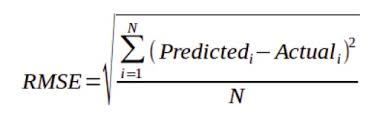

R^2 is a statistical measure that represents how well of a fit a regression model is. The ideal value is 1. R-square is a comparison of residual sum of squares (SSres) with total sum of squares(SStot). Total sum of squares is calculated by summation of squares of perpendicular distance between data points and the average line. ([GeeksForGeeks](https://www.geeksforgeeks.org/ml-r-squared-in-regression-analysis/)).



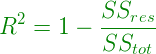

In [ ]:
import math
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from statistics import mean

### Visualization Modules

Graphviz is used to model a decision tree as an image that the reader can read.

In [ ]:
import graphviz

## Experiments 

### First Regression

In the chart below are the features the first regression will be using after removing those features based on correlation and variance.

In [ ]:
num_rows, num_cols = X_df.shape

In [ ]:
col_left = (num_cols / df_models_cols) * 100

In [ ]:
print("After removing the features based on correlation and variance, we now have {} instances and {} columns".format(num_rows, num_cols))
print("We are now using {}% of the starting columns".format(col_left))

After removing the features based on correlation and variance, we now have 30293 instances and 38 columns
We are now using 20.87912087912088% of the starting columns


In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['Feature',]),
                               cells=dict(values=[X_df.columns]))])
fig.show()

In [ ]:
kf =KFold(n_splits=10)

In [ ]:
dr = DummyRegressor()
dt = DecisionTreeRegressor()
rfr = RandomForestRegressor()
regr = svm.SVR()

In [ ]:
d_scores = []
dt_scores = []
rfr_scores = []
svm_scores = []

dummy_r2scores = []
dt_r2scores = []
rfr_r2scores = []
svm_r2scores = []

for train_index, test_index in kf.split(X_values, y_values):
  X_train, X_test = X_values[train_index], X_values[test_index]
  y_train, y_test = y_values[train_index], y_values[test_index]

  dr = dr.fit(X_train, y_train)
  dt = dt.fit(X_train, y_train)
  rfr = rfr.fit(X_train, y_train)
  regr = regr.fit(X_train, y_train)

  dr_predY = dr.predict(X_test)
  dt_predY = dt.predict(X_test)
  rf_predY = rfr.predict(X_test)
  svm_predY = regr.predict(X_test)

  dr_RMSE = round(math.sqrt(mean_squared_error(y_test, dr_predY)),2)
  dt_RMSE = round(math.sqrt(mean_squared_error(y_test, dt_predY)),2)
  rfr_RMSE = round(math.sqrt(mean_squared_error(y_test, rf_predY)),2)
  svm_RMSE = round(math.sqrt(mean_squared_error(y_test, svm_predY)),2)

  d_scores.append(dr_RMSE)
  dt_scores.append(dt_RMSE)
  rfr_scores.append(rfr_RMSE)
  svm_scores.append(svm_RMSE)

  dummy_r2scores.append(r2_score(y_test, dr_predY))
  dt_r2scores.append(r2_score(y_test, dt_predY))
  rfr_r2scores.append(r2_score(y_test, rf_predY))
  svm_r2scores.append(r2_score(y_test, svm_predY))

### Results of First Regression

Below are the average, maximum and minimum RMSE scores for each model in the first table, and in the second table, there are the average, maximum and minimum R2 scores of each model. Finally, I modeled the Decision Tree, however, it is very large and hard to read from the output,but you are welcome to scroll through it.

In [ ]:
from prettytable import PrettyTable

In [ ]:
d_stats = ['Dummy Regressor', mean(d_scores), max(d_scores), min(d_scores)]
dt_stats = ['Decision Tree', mean(dt_scores), max(dt_scores), min(dt_scores)]
rfr_stats = ['Random Forest', mean(rfr_scores), max(rfr_scores), min(rfr_scores)]
svm_stats = ['SVR', mean(svm_scores), max(svm_scores), min(svm_scores)]

In [ ]:
myTable = PrettyTable(["Model", 'Average RMSE', 'Max RMSE', 'Min RMSE'])
myTable.add_row(d_stats)
myTable.add_row(dt_stats)
myTable.add_row(rfr_stats)
myTable.add_row(svm_stats)

In [ ]:
d_stats = ['Dummy Regressor', mean(dummy_r2scores), max(dummy_r2scores), min(dummy_r2scores)]
dt_stats = ['Decision Tree', mean(dt_r2scores), max(dt_r2scores), min(dt_r2scores)]
rfr_stats = ['Random Forest', mean(rfr_r2scores), max(rfr_r2scores), min(rfr_r2scores)]
svm_stats = ['SVR', mean(svm_r2scores), max(svm_r2scores), min(svm_r2scores)]

In [ ]:
myTable1 = PrettyTable(["Model", 'Average R2', 'Max R2', 'Min R2'])
myTable1.add_row(d_stats)
myTable1.add_row(dt_stats)
myTable1.add_row(rfr_stats)
myTable1.add_row(svm_stats)

#### Visuals of Results and Analysis

In [ ]:
print(myTable)

+-----------------+--------------+----------+----------+
|      Model      | Average RMSE | Max RMSE | Min RMSE |
+-----------------+--------------+----------+----------+
| Dummy Regressor |    0.487     |   0.66   |   0.32   |
|  Decision Tree  |     0.32     |   0.47   |   0.17   |
|  Random Forest  |    0.247     |   0.41   |   0.1    |
|       SVR       |    0.227     |   0.34   |   0.12   |
+-----------------+--------------+----------+----------+


In [ ]:
print(myTable1)

+-----------------+---------------------+-----------------------+----------------------+
|      Model      |      Average R2     |         Max R2        |        Min R2        |
+-----------------+---------------------+-----------------------+----------------------+
| Dummy Regressor | -0.2229674669512787 | -0.020384741879065027 | -0.8125734858794047  |
|  Decision Tree  |  0.4218256813970143 |   0.8153734834295169  | -0.18461500612667847 |
|  Random Forest  |  0.6486276476132228 |   0.8820860482324272  | 0.01008038834656122  |
|       SVR       |  0.6992938515247175 |   0.8768540688596356  |  0.2797102843785707  |
+-----------------+---------------------+-----------------------+----------------------+


From the results of the Kfold Cross validation show us that every model beat the baseline Dummy Regressor, that shows that each model is acceptable to use. However, from the three, we can see that the best performing regressor is the Simple Vector Machine (SVR), then the Random Forest (RF), and finally the Decision Tree (DT). In this first regression, the average RMSE for each are 0.227, 0.247 and 0.32, respectively. While the baseline was 0.487. I did beat the state of the art RMSE for the Random Forest, which was 0.25886, while mine was 0.247. However, my other models (SVR and RF) wer able to beat out the RMSE of the Decision Tree. I could not find comparable RMSE scores for the other notebooks, so I can not compare the RMSE scores for SVR and RF to them. However, I did find them for the R^2 scores. Furthering the RMSE discussion, the lowest RMSE was 0.10 by the RF, with the SVR performing at 0.12 at its best, and the DT performed at 0.17 at its best. However, at their worst, the SVR performed the best at 0.34, while RF performed at 0.41 and DT performed poorly at 0.47. Although, RF had the lowest RMSE score, it still performed the second best due to its poor performance in some of the folds. This ranking followed suit in the R^2 scores, as well.

In the R^2 table, we can see that the SVR performed the best at an average of 0.6993, then RF at 0.6486, and finally DT at 0.42. Compared to the state of the art results, my regression performed poorly for RF and DT if we compared the average R^2, as the best I could find for RF was 0.932057, while my average was 0.6486, but we compared the maximum score, it was not much lower at 0.8821, but as a whole, the RF performed poorly in relation to others. For DT, the state of the art score was 0.87650, while my average R^2 score was 0.4218, a significant performance drop, but again, if we looked at the Maximum R^2 score, it did not perform that much worse, as it scored 0.8154, but as a whole, it performed poorly.

Finally, looking at the state of the art for SVR, which was 0.4394 while my average was 0.6993, my model performed much better than that. Although, it performed at 0.2797 at its worse, but in the overall sense, it was better than the state of the art.

Comparing the first regression results to the state of the art results, only the SVR performed better than them.

In [ ]:
dot_data = tree.export_graphviz(dt, out_file=None, 
                                feature_names=X_df.columns,  
                                filled=True)
graphviz.Source(dot_data, format="png") 

### Feature Reduction

Since the Support Vector Regression, and the Random Forest Regressor performed about the same, althought the SVR performed slightly in both RMSE and R^2, I will be using the coefficients from the Random Forest to reduce my features in order to see which ones are important and if the removal of the extra features will improve the models, or will they get worse.

To reduce the number of features, I am using the "[SelectFromModel](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.SelectFromModel.html)" module from sklearn's feature_selection. This will tranform the data by selecting features based on the importance of the features.

In [ ]:
from sklearn.feature_selection import SelectFromModel

sfm = SelectFromModel(rfr, threshold=0.005)
sfm.fit(X_values, y_values)

SelectFromModel(estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0,
                                                criterion='mse', max_depth=None,
                                                max_features='auto',
                                                max_leaf_nodes=None,
                                                max_samples=None,
                                                min_impurity_decrease=0.0,
                                                min_impurity_split=None,
                                                min_samples_leaf=1,
                                                min_samples_split=2,
                                                min_weight_fraction_leaf=0.0,
                                                n_estimators=100, n_jobs=None,
                                                oob_score=False,
                                                random_state=None, verbose=0,
                                                war

In [ ]:
important_indexes = list(sfm.get_support(indices=True))
X_df_columns = X_df.columns
matched = [X_df_columns[i] for i in important_indexes]

Below are the features that have successfully passed the threshold of 0.005 for importance and will be used in the next regression.

In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['Feature',]),
                               cells=dict(values=[matched]))])
fig.show()

In [ ]:
col_left = (len(matched) / df_models_cols) * 100

In [ ]:
print("After removing features based on importance, we are now using {} columns, or {}% of the starting columns.".format(len(matched), col_left))

After removing features based on importance, we are now using 16 columns, or 8.791208791208792% of the starting columns


In [ ]:
X_values = sfm.transform(X_values)

In [ ]:
d_scores = []
dt_scores = []
rfr_scores = []
svm_scores = []

dummy_r2scores = []
dt_r2scores = []
rfr_r2scores = []
svm_r2scores = []

for train_index, test_index in kf.split(X_values, y_values):
  X_train, X_test = X_values[train_index], X_values[test_index]
  y_train, y_test = y_values[train_index], y_values[test_index]

  dr = dr.fit(X_train, y_train)
  dt = dt.fit(X_train, y_train)
  rfr = rfr.fit(X_train, y_train)
  regr = regr.fit(X_train, y_train)

  dr_predY = dr.predict(X_test)
  dt_predY = dt.predict(X_test)
  rf_predY = rfr.predict(X_test)
  svm_predY = regr.predict(X_test)

  dr_RMSE = round(math.sqrt(mean_squared_error(y_test, dr_predY)),2)
  dt_RMSE = round(math.sqrt(mean_squared_error(y_test, dt_predY)),2)
  rfr_RMSE = round(math.sqrt(mean_squared_error(y_test, rf_predY)),2)
  svm_RMSE = round(math.sqrt(mean_squared_error(y_test, svm_predY)),2)

  d_scores.append(dr_RMSE)
  dt_scores.append(dt_RMSE)
  rfr_scores.append(rfr_RMSE)
  svm_scores.append(svm_RMSE)

  dummy_r2scores.append(r2_score(y_test, dr_predY))
  dt_r2scores.append(r2_score(y_test, dt_predY))
  rfr_r2scores.append(r2_score(y_test, rf_predY))
  svm_r2scores.append(r2_score(y_test, svm_predY))

In [ ]:
d_stats = ['Dummy Regressor', mean(d_scores), max(d_scores), min(d_scores)]
dt_stats = ['Decision Tree', mean(dt_scores), max(dt_scores), min(dt_scores)]
rfr_stats = ['Random Forest', mean(rfr_scores), max(rfr_scores), min(rfr_scores)]
svr_stats = ['SVR', mean(svm_scores), max(svm_scores), min(svm_scores)]

In [ ]:
myTable2 = PrettyTable(["Model", 'Average RMSE', 'Max RMSE', 'Min RMSE'])
myTable2.add_row(d_stats)
myTable2.add_row(dt_stats)
myTable2.add_row(rfr_stats)
myTable2.add_row(svr_stats)

In [ ]:
d_stats = ['Dummy Regressor', mean(dummy_r2scores), max(dummy_r2scores), min(dummy_r2scores)]
dt_stats = ['Decision Tree', mean(dt_r2scores), max(dt_r2scores), min(dt_r2scores)]
rfr_stats = ['Random Forest', mean(rfr_r2scores), max(rfr_r2scores), min(rfr_r2scores)]
svr_stats = ['SVR', mean(svm_r2scores), max(svm_r2scores), min(svm_r2scores)]

In [ ]:
myTable3 = PrettyTable(["Model", 'Average R2', 'Max R2', 'Min R2'])
myTable3.add_row(d_stats)
myTable3.add_row(dt_stats)
myTable3.add_row(rfr_stats)
myTable3.add_row(svr_stats)

#### Tables of Results & Analysis

In [ ]:
print(myTable2)

+-----------------+--------------+----------+----------+
|      Model      | Average RMSE | Max RMSE | Min RMSE |
+-----------------+--------------+----------+----------+
| Dummy Regressor |    0.487     |   0.66   |   0.32   |
|  Decision Tree  |    0.304     |   0.47   |   0.16   |
|  Random Forest  |    0.246     |   0.42   |   0.11   |
|       SVR       |    0.216     |   0.35   |   0.12   |
+-----------------+--------------+----------+----------+


In [ ]:
print(myTable3)

+-----------------+---------------------+-----------------------+----------------------+
|      Model      |      Average R2     |         Max R2        |        Min R2        |
+-----------------+---------------------+-----------------------+----------------------+
| Dummy Regressor | -0.2229674669512787 | -0.020384741879065027 | -0.8125734858794047  |
|  Decision Tree  |  0.4792495491770424 |   0.7751825264825797  | -0.24657825595571947 |
|  Random Forest  |  0.6485783986464633 |   0.8716759828267245  | -0.07545492813333121 |
|       SVR       |  0.7347098474671268 |   0.8949080185131549  |  0.4247409569484737  |
+-----------------+---------------------+-----------------------+----------------------+


The results from the restricted regression are above. Across the board, the scores for both RMSE and R^2 improved. Starting with the RMSE values, the Dummy Regressor did not changed, as it should not. The average RMSE for DT was 0.32 previously, and now is 0.304, a decrease of almost 0.02. The average RMSE of RF was 0.247 and is is now 0.246, a decrease of 0.001. And finally, the average RMSE for SVR was 0.227 and is now 0.216, a decrease of 0.011. However, for all, the maximum and minimum RMSE scores were approximately the same for each, but we can infer that the other RMSE scores are lower than what they were before. We did beat the average RMSE for RF compared to the state of the art.

Now, looking at the R^2 scores, there is a large increase in the score for DT and SVR. For DT, it was 0.4218, and is now 0.4792, a increase of over 0.05. And for SVR, it increased by almost 0.04, from 0.6993 to 0.7347. Although, these scores went up for these models, the maximum and minimum R^2 score for DT, actually went down. This is interesting since the average went up. This case is not the same for SVR, as it saw a slight increase in its maximum score (0.8768 -> 0.8949), and a large increase in the minimum score of the R^2 score (0.2797 -> 0.4247). This is a noticeable increase in R^2 score for the SVR, and it shows that our model is improving with the removal of the other features. The R^2 scores for the RF did not changed significantly, and no noteworthy changes in either column. Again, the only R^2 score that beat the state of the art was the SVR.

Overall, the removal of the features did help our models improve. It shows that these models are more important in determing the MSRP of a new car.

### One More Feature Reduction and Regression

I am going to run one more regression, but this time I am increasing the threshold for SelectFromModel module.

In [ ]:
sfm = SelectFromModel(rfr, threshold=0.02)
sfm.fit(X_values, y_values)

SelectFromModel(estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0,
                                                criterion='mse', max_depth=None,
                                                max_features='auto',
                                                max_leaf_nodes=None,
                                                max_samples=None,
                                                min_impurity_decrease=0.0,
                                                min_impurity_split=None,
                                                min_samples_leaf=1,
                                                min_samples_split=2,
                                                min_weight_fraction_leaf=0.0,
                                                n_estimators=100, n_jobs=None,
                                                oob_score=False,
                                                random_state=None, verbose=0,
                                                war

In [ ]:
important_indexes = list(sfm.get_support(indices=True))

In [ ]:
new_matched = [matched[i] for i in important_indexes]

In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['Feature',]),
                               cells=dict(values=[new_matched]))])
fig.show()

In [ ]:
col_left = (len(new_matched) / df_models_cols) * 100

In [ ]:
print("After removing features based on importance, we are now using {} columns, or {}% of the starting columns.".format(len(new_matched), col_left))

After removing features based on importance, we are now using 10 columns, or 5.4945054945054945% of the starting columns.


In [ ]:
X_values = sfm.transform(X_values)

In [ ]:
d_scores = []
dt_scores = []
rfr_scores = []
svm_scores = []

dummy_r2scores = []
dt_r2scores = []
rfr_r2scores = []
svm_r2scores = []

for train_index, test_index in kf.split(X_values, y_values):
  X_train, X_test = X_values[train_index], X_values[test_index]
  y_train, y_test = y_values[train_index], y_values[test_index]

  dr = dr.fit(X_train, y_train)
  dt = dt.fit(X_train, y_train)
  rfr = rfr.fit(X_train, y_train)
  regr = regr.fit(X_train, y_train)

  dr_predY = dr.predict(X_test)
  dt_predY = dt.predict(X_test)
  rf_predY = rfr.predict(X_test)
  svm_predY = regr.predict(X_test)

  dr_RMSE = round(math.sqrt(mean_squared_error(y_test, dr_predY)),2)
  dt_RMSE = round(math.sqrt(mean_squared_error(y_test, dt_predY)),2)
  rfr_RMSE = round(math.sqrt(mean_squared_error(y_test, rf_predY)),2)
  svm_RMSE = round(math.sqrt(mean_squared_error(y_test, svm_predY)),2)

  d_scores.append(dr_RMSE)
  dt_scores.append(dt_RMSE)
  rfr_scores.append(rfr_RMSE)
  svm_scores.append(svm_RMSE)

  dummy_r2scores.append(r2_score(y_test, dr_predY))
  dt_r2scores.append(r2_score(y_test, dt_predY))
  rfr_r2scores.append(r2_score(y_test, rf_predY))
  svm_r2scores.append(r2_score(y_test, svm_predY))

In [ ]:
d_stats = ['Dummy Regressor', mean(d_scores), max(d_scores), min(d_scores)]
dt_stats = ['Decision Tree', mean(dt_scores), max(dt_scores), min(dt_scores)]
rfr_stats = ['Random Forest', mean(rfr_scores), max(rfr_scores), min(rfr_scores)]
svr_stats = ['SVR', mean(svm_scores), max(svm_scores), min(svm_scores)]

In [ ]:
myTable3 = PrettyTable(["Model", 'Average RMSE', 'Max RMSE', 'Min RMSE'])
myTable3.add_row(d_stats)
myTable3.add_row(dt_stats)
myTable3.add_row(rfr_stats)
myTable3.add_row(svr_stats)

In [ ]:
d_stats = ['Dummy Regressor', mean(dummy_r2scores), max(dummy_r2scores), min(dummy_r2scores)]
dt_stats = ['Decision Tree', mean(dt_r2scores), max(dt_r2scores), min(dt_r2scores)]
rfr_stats = ['Random Forest', mean(rfr_r2scores), max(rfr_r2scores), min(rfr_r2scores)]
svr_stats = ['SVR', mean(svm_r2scores), max(svm_r2scores), min(svm_r2scores)]

In [ ]:
myTable4 = PrettyTable(["Model", 'Average R2', 'Max R2', 'Min R2'])
myTable4.add_row(d_stats)
myTable4.add_row(dt_stats)
myTable4.add_row(rfr_stats)
myTable4.add_row(svr_stats)

In [ ]:
print(myTable3)

+-----------------+--------------+----------+----------+
|      Model      | Average RMSE | Max RMSE | Min RMSE |
+-----------------+--------------+----------+----------+
| Dummy Regressor |    0.487     |   0.66   |   0.32   |
|  Decision Tree  |    0.314     |   0.52   |   0.16   |
|  Random Forest  |    0.258     |   0.48   |   0.12   |
|       SVR       |    0.229     |   0.39   |   0.14   |
+-----------------+--------------+----------+----------+


In [ ]:
print(myTable4)

+-----------------+---------------------+-----------------------+---------------------+
|      Model      |      Average R2     |         Max R2        |        Min R2       |
+-----------------+---------------------+-----------------------+---------------------+
| Dummy Regressor | -0.2229674669512787 | -0.020384741879065027 | -0.8125734858794047 |
|  Decision Tree  | 0.41871965900345554 |   0.7381638201993028  | -0.6026729050193913 |
|  Random Forest  |  0.5839411689389834 |   0.862672746064252   | -0.3925448790667958 |
|       SVR       |  0.7020748904270111 |   0.8847618493164497  | 0.44292261919925124 |
+-----------------+---------------------+-----------------------+---------------------+


#### Analysis

The results of the third regression showed a decrease in the performacne of every model. The features I dropped from the second regression were important in determining the MSRP of new cars. Every average RMSE score for each model raised by about 0.01, which shows a decline in the performance of the model. And comparing our R^2 scores, the average R^2 for DT dropped by 0.06, for RF it dropped by 0.06 and for SVR it dropped by 0.03. Additionally, the Maximum R^2 scores dropped for all, as well, and for each of the minimum R^2 scores decreased for all. From the results of the regression, we can say that the features we dropped were significant in the model, and should have stayed in our model.

# Conclusions

Throughout the three regressions we performed, I was able to find the features that were the most important to predicting the MSRP of a new car. We started with 56 features with a mix of both numerical information and categorical information. After dummy encoding and label encoding, we started with 182 features. But, before running our first regression, we removed features based on correlation (removing features highly correlated with each other), and features with low variance (most of the values in the features are the same). After that process, we had 38 columns left, or 20.87912087912088% of the starting columns. From the results of the first regression, we saw that each model beat the baseline of the Dummy Regressor, which had an average RMSE of 0.487 and R^2 of -0.2229. The Decision Tree averaged a score of 0.32 for RMSE and 0.4218 for R^2. Random Forest had an average RMSE of 0.247 and R^2 of 0.6486. While the SVR had an average RMSE of 0.227 and R^2 of 0.6993. From the first regression, we saw that the SVR performed the best based on both metrics, but almost none of the models, apart from SVR R^2 and the RF RMSE beat the scores from the state of the art.

Then, we ran a second regression, this differed from the first regression, as I selected only the features that had an importance of over 0.005, which reduced the number of columns from 38 to 16, or 8.791208791208792% of the original columns. The results from this regression actually improved almost every performance metric for each model.The average RMSE for DT was 0.32 previously, and now is 0.304, a decrease of almost 0.02. The average RMSE of RF was 0.247 and is is now 0.246, a decrease of 0.001. And finally, the average RMSE for SVR was 0.227 and is now 0.216, a decrease of 0.011. There was a large increase in the score for DT and SVR. For DT, it was 0.4218, and is now 0.4792, a increase of over 0.05. And for SVR, it increased by almost 0.04, from 0.6993 to 0.7347. Although, these scores went up for these models, the maximum and minimum R^2 score for DT, actually went down. This is interesting since the average went up. This case is not the same for SVR, as it saw a slight increase in its maximum score (0.8768 -> 0.8949), and a large increase in the minimum score of the R^2 score (0.2797 -> 0.4247). This is a noticeable increase in R^2 score for the SVR, and it shows that our model is improving with the removal of the other features.

Finally, we did one last regression where we increased the threshold for feature importance, which dropped the number of features to 10, or 5.4945054945054945% of the original features. However, the results of the this final regression did not improve the model, but hurt the performance of the model. Across the board, there was 0.01 increase in average RMSE score and a drop of almost 0.06 for each model. This proved to me that the features we dropped were significant in our models. Furthering that idea, the scores for the final regression were worse than the scores from both the first regression and the second regression, which leads to the conclusion that the best set of features for my models were the features from the second regression.

As a whole, my models did necessarily beat the state of the art scores, my average R^2 scores for DT and RF were much lower than what was found by others. But, the state of the art R^2 SVR score was beat significantly by my model, which meant my data was better prepared for this model as compared to the others. And finally, the my average RMSE for RF beat the state of the art score in the first and second regressions, but failed to beat it in the third regression.

In conclusion, I expected the Random Forest and Support Vector Regressor to perform the best, as the Random Forest is a collection of Decision trees that work together to determine their prediction compared to the one decision tree from the Decision Tree Regressor. I suspected that the Support Vector Regressor would perform well, as well since the Support Vector Machine is a good classifier model used in many classification tasks, and since it uses the same techniques as that, I assumed it would perform well. In all cases, the SVR performed the best with the Random Forest performing the second best in the experiments.

Below is the table of the features, I believe to be the most important features, based on our regression results.

In [ ]:
fig = go.Figure(data=[go.Table(header=dict(values=['Feature',]),
                               cells=dict(values=[matched]))])
fig.show()

# Honor Code

“As a student at Union College, I am part of a community that values intellectual effort, curiosity and discovery. I understand that in order to truly claim my educational and academic achievements, I am obligated to act with academic integrity. Therefore, I affirm that I will carry out my academic endeavors with full academic honesty, and I rely on my fellow students to do the same.”
